In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from os import listdir
from os.path import isfile, join, splitext
import skfuzzy as fuzz
from sklearn.cluster import KMeans

In [2]:
from os import listdir


input_dir = '../dataset/test'
output_dir = '../dataset/output'
gt_dir = '../dataset/groundtruth'
numImages = 80

onlyfiles = [f for f in listdir(input_dir) if isfile(join(input_dir, f))]
files = onlyfiles[0:numImages]

In [3]:
def showSubplotImage(img, titlestr=""):
    plt.imshow(img, cmap='gray', interpolation='bicubic', vmin=0, vmax=255)
    plt.xticks([]), plt.yticks([])
    plt.title(titlestr)
    plt.show()

def setSubplotImage(img, titlestr=""):
    n = len(img)  # Number of images
    
    if n <= 6:
        # If 6 or fewer images, show in a single row
        cols = n
        rows = 1
    else:
        # Otherwise, calculate rows and columns
        cols = int(np.ceil(np.sqrt(n)))
        rows = int(np.ceil(n / cols))

    # Create subplots
    fig, axs = plt.subplots(rows, cols, figsize=(15, 15))
    axs = axs.ravel()  # Flatten axes for easy indexing

    for i in range(n):
        axs[i].imshow(img[i], cmap='gray', vmin=0, vmax=255)
        axs[i].set_title(titlestr[i] if i < len(titlestr) else "")
        axs[i].axis('off')  # Turn off axes

    # Hide any unused subplots
    for i in range(n, len(axs)):
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()


In [4]:
def filter (image):
    blur1 = cv2.blur(image,(13,13))
    blur2 = cv2.GaussianBlur(image,(15,15),0)
    blur3 = cv2.medianBlur(image,5)

    # Extract details
    details_1 = cv2.subtract(image, blur1)
    shp_1 = cv2.add(image, details_1)

    details_2 = cv2.subtract(image, blur2)
    shp_2 = cv2.add(image, details_2)

    details_3 = cv2.subtract(image, blur3)
    shp_3 = cv2.add(image, details_3)
    
    setSubplotImage([blur1,blur2,blur3],titlestr=['average', 'gaussian' , 'median']);
    setSubplotImage([shp_1,shp_2,shp_3],titlestr=['shp_1', 'shp_2' , 'shp_3']);

    return shp_2


In [5]:
window_size = 7
constant_c = 10

def mean_C_thresholding(img, window_size, constant_C):
    # Step 1: Apply mean filter
    kernel = np.ones((window_size, window_size), np.float32) / (window_size * window_size)
    mean_filtered = cv2.filter2D(img, -1, kernel)
    
    # Step 2: Calculate difference image
    difference_image = img - mean_filtered
    
    # Step 3: Threshold the difference image
    _, thresholded_image = cv2.threshold(difference_image, constant_C, 255, cv2.THRESH_BINARY)
    

    # setSubplotImage([img, difference_image, thresholded_image], ["Original", "difference", "Isodata"])
    
    return thresholded_image,

def thresholding (img):


    _, otsu_thresh = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    _,globalThreshold = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)

    Canny_image =  cv2.Canny(img,200,230)

    mean_C_img = mean_C_thresholding(img, 3, 10)


    setSubplotImage([ otsu_thresh, globalThreshold,Canny_image], [ "Otsu", "global", "Canny"])

    return Canny_image

In [6]:
kernel = np.ones((5,5),np.uint8)

morph_map ={
    'open':cv2.MORPH_OPEN,
    'close':cv2.MORPH_CLOSE,
    'gradient':cv2.MORPH_GRADIENT,
    'tophat':cv2.MORPH_TOPHAT,
    'blackhat':cv2.MORPH_BLACKHAT,
    'dilation':cv2.MORPH_DILATE ,
    'erosion':cv2.MORPH_ERODE
}

def multiple_MORPH(img, kernel, iterations,option):
    morph_type = morph_map.get(option)
    exp = cv2.morphologyEx(img, morph_type, kernel, iterations=iterations)
    plt.subplot(121), plt.imshow(img, cmap='gray')
    plt.title('Original Image'), plt.axis('off')
    plt.subplot(122), plt.imshow(exp, cmap='gray')
    plt.title(f'Morphological {option}'), plt.axis('off')
    plt.show()
    return exp

In [7]:
def preProcess(img):

    green_channel = cv2.split(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))[1]
    # grey_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # setSubplotImage([green_channel, grey_img], ["Original", "Grey Scale"])

    # clahe_23 = cv2.createCLAHE(clipLimit=0.023, tileGridSize=(8, 8))
    clahe_2 = cv2.createCLAHE(clipLimit=2, tileGridSize=(8, 8))

    # clahe_23_img = clahe_23.apply(green_channel)
    clahe_2_img = clahe_2.apply(green_channel)

    # setSubplotImage([green_channel, clahe_23_img,clahe_2_img], ["Original", "clahe_23_img",'clahe_2_img'])

    # clahe_23_Greyimg = clahe_23.apply(grey_img)
    # clahe_2_Greyimg = clahe_2.apply(grey_img)

    # setSubplotImage([green_channel, clahe_23_Greyimg,clahe_2_Greyimg], ["Grey_Scale","clahe_23_Greyimg","clahe_2_Greyimg"])

    ## select clahe 2

    # apply filter and sharpening
    
    filterImg = filter(clahe_2_img)

    # thresholding(filterImg)

    # thresholded_image =  cv2.Canny(filterImg,200,230)

    img = thresholding(filterImg)

    return img

    

: 

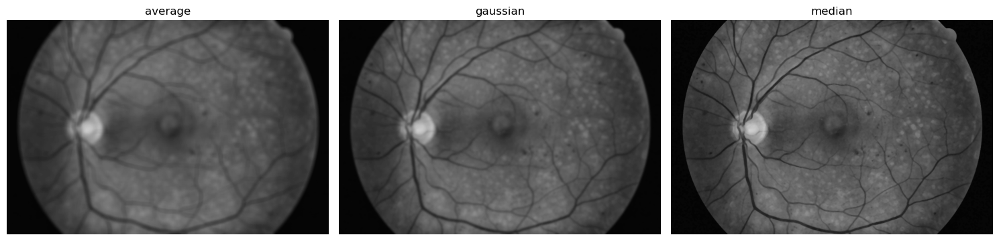

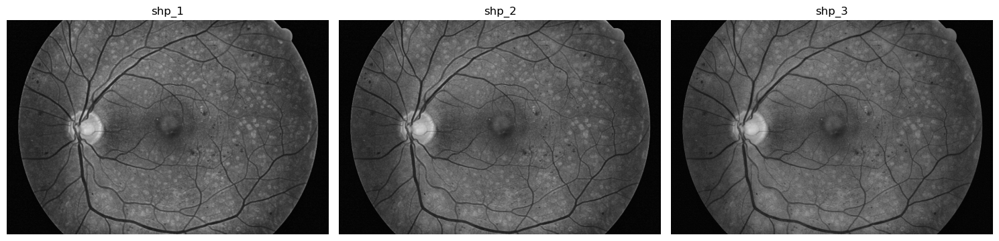

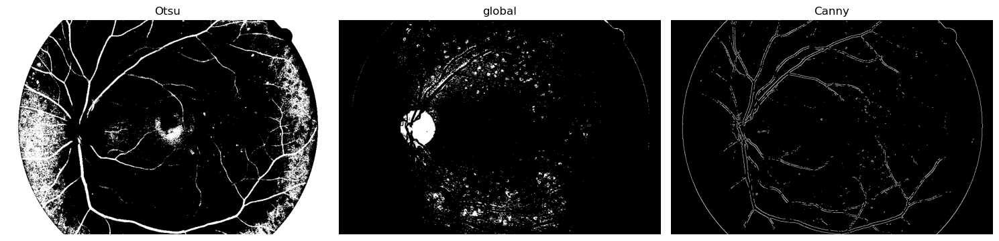

Applying Morphological Operation: open


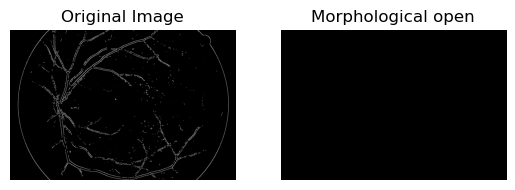

Applying Morphological Operation: close


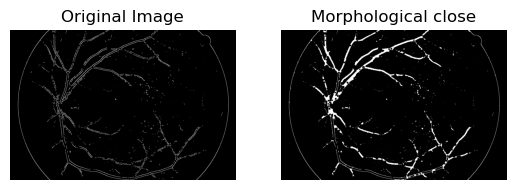

Applying Morphological Operation: gradient


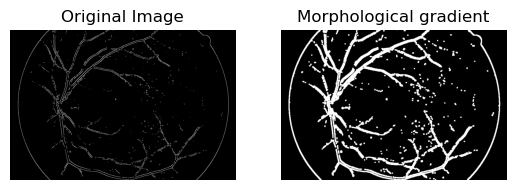

Applying Morphological Operation: tophat


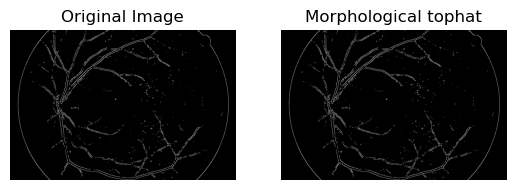

Applying Morphological Operation: blackhat


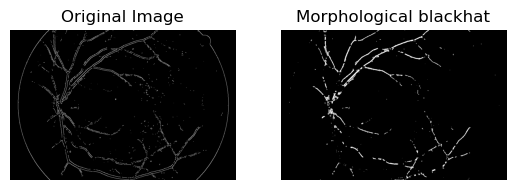

Applying Morphological Operation: dilation


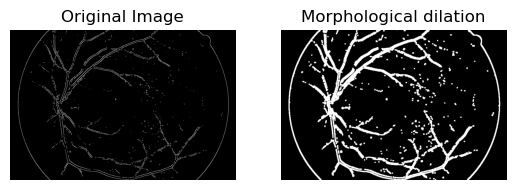

Applying Morphological Operation: erosion


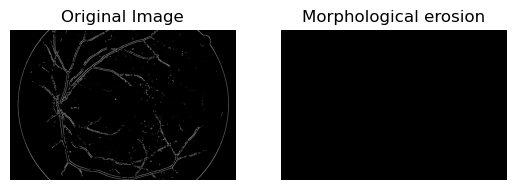

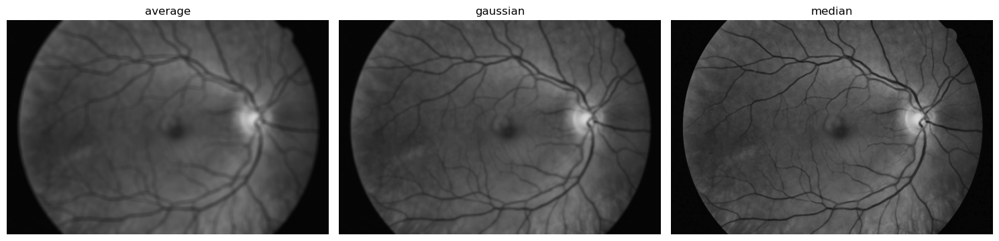

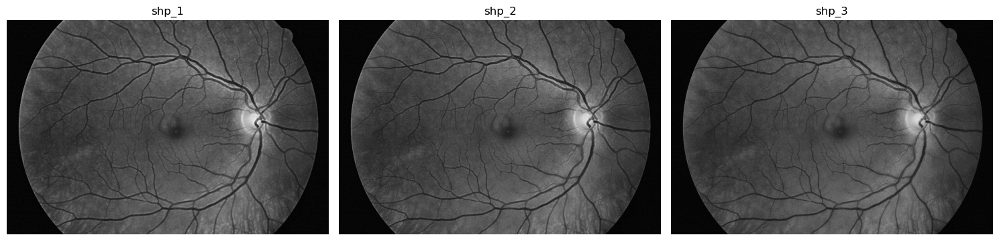

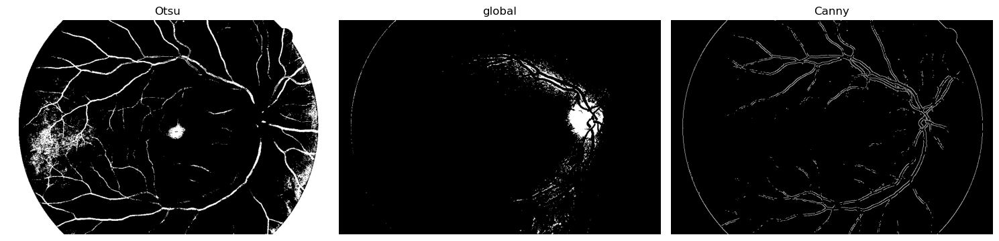

Applying Morphological Operation: open


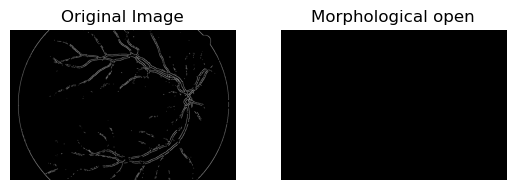

Applying Morphological Operation: close


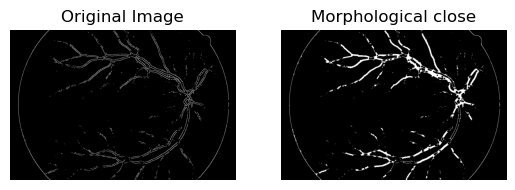

Applying Morphological Operation: gradient


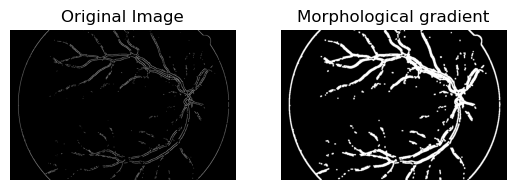

Applying Morphological Operation: tophat


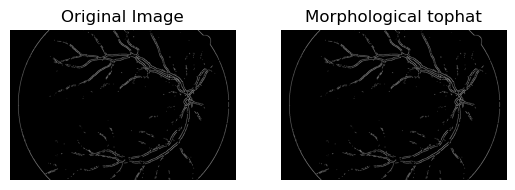

Applying Morphological Operation: blackhat


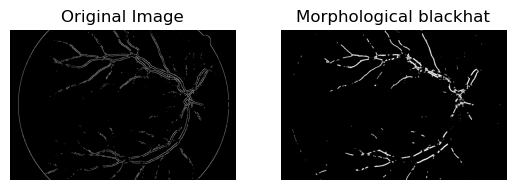

Applying Morphological Operation: dilation


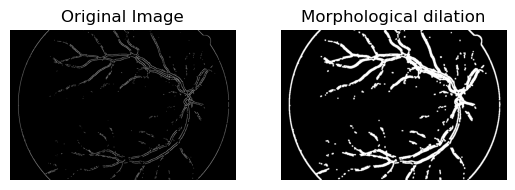

Applying Morphological Operation: erosion


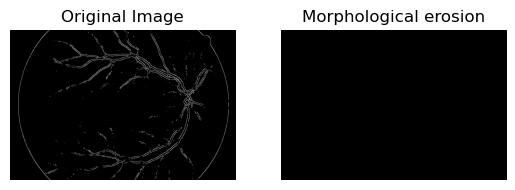

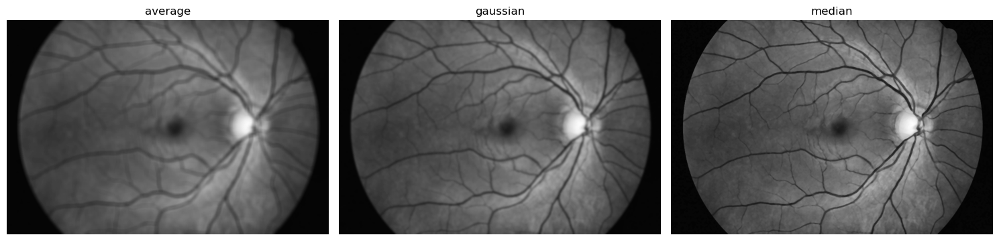

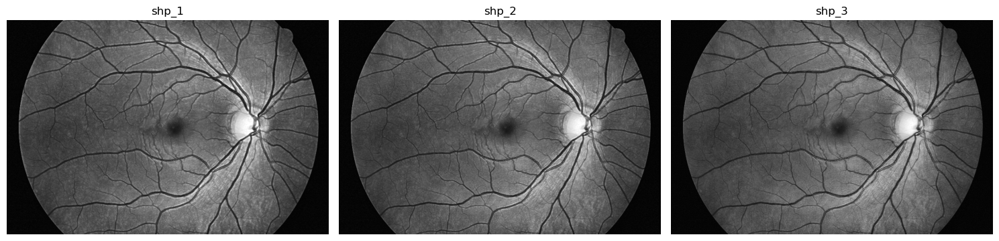

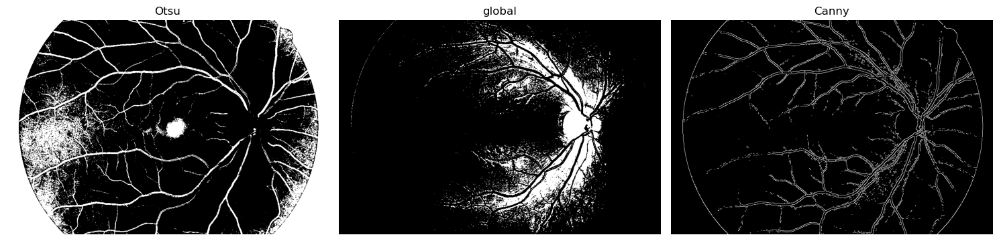

Applying Morphological Operation: open


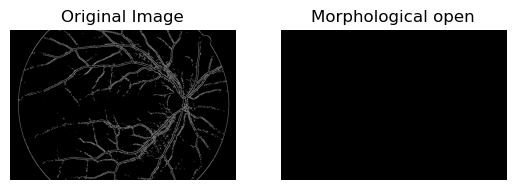

Applying Morphological Operation: close


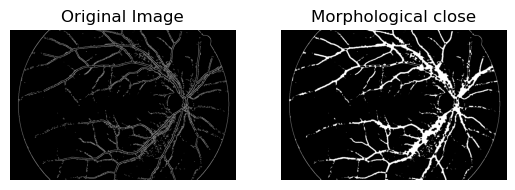

Applying Morphological Operation: gradient


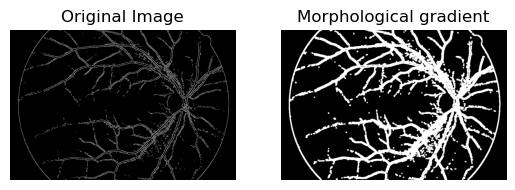

Applying Morphological Operation: tophat


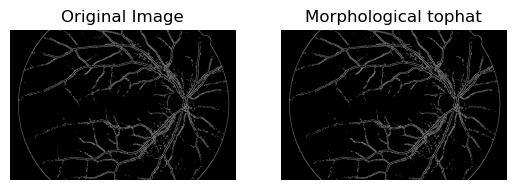

Applying Morphological Operation: blackhat


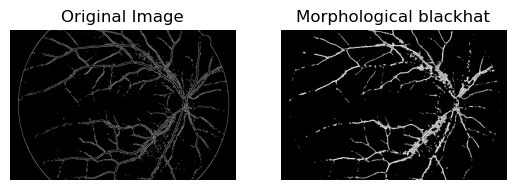

Applying Morphological Operation: dilation


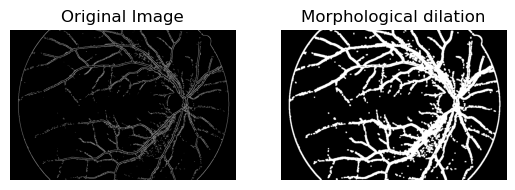

Applying Morphological Operation: erosion


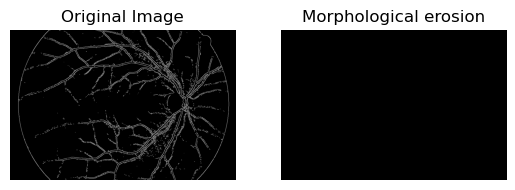

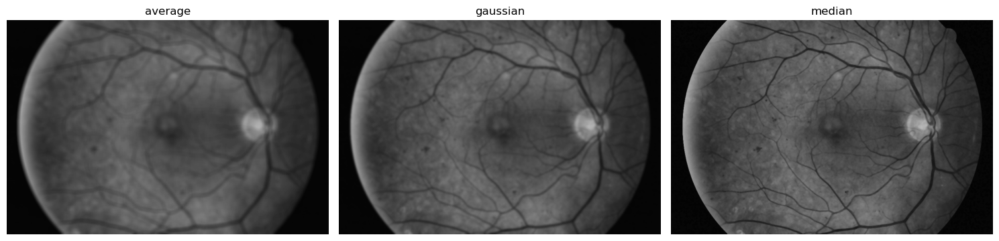

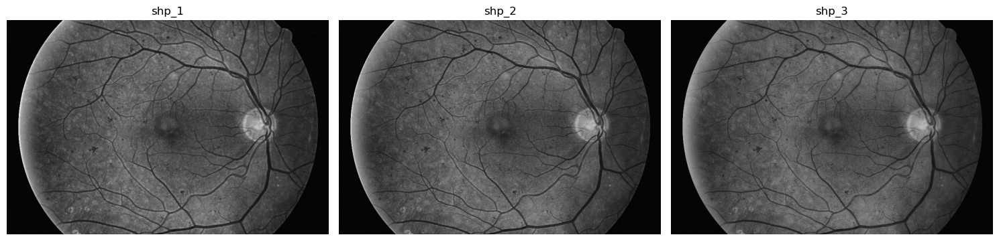

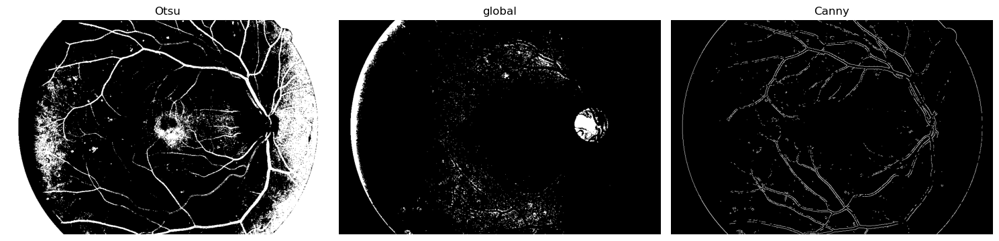

Applying Morphological Operation: open


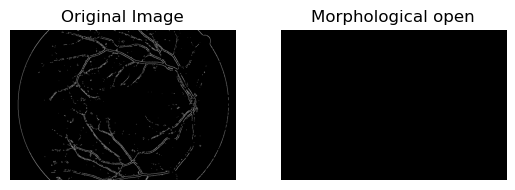

Applying Morphological Operation: close


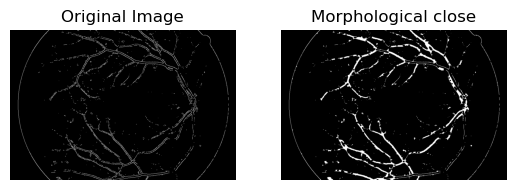

Applying Morphological Operation: gradient


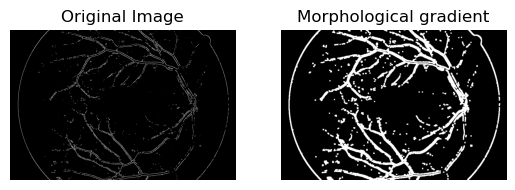

Applying Morphological Operation: tophat


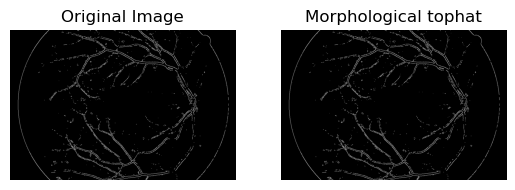

Applying Morphological Operation: blackhat


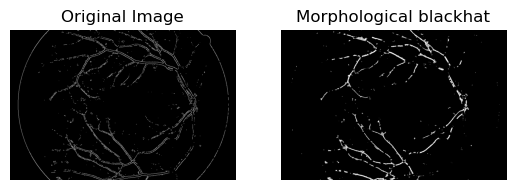

Applying Morphological Operation: dilation


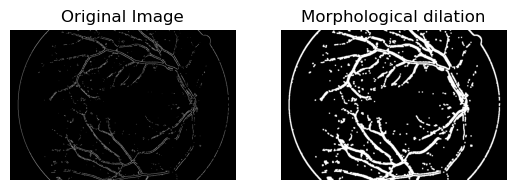

Applying Morphological Operation: erosion


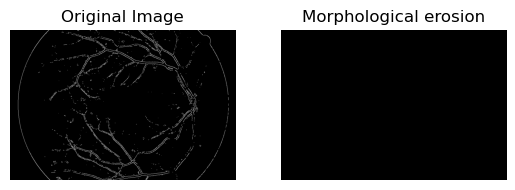

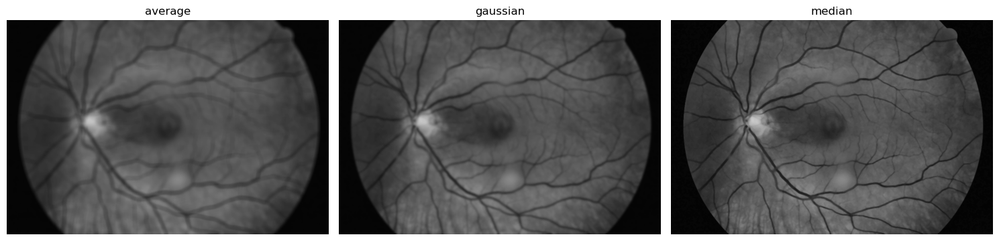

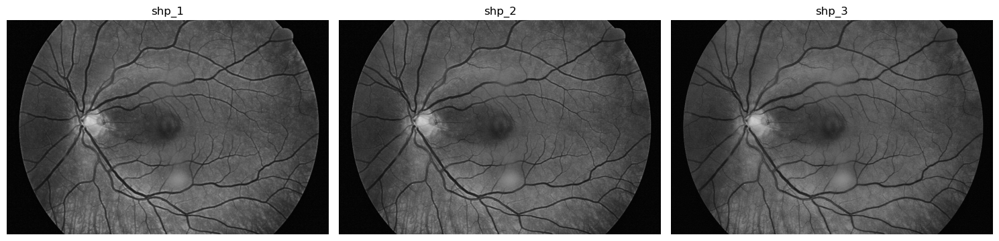

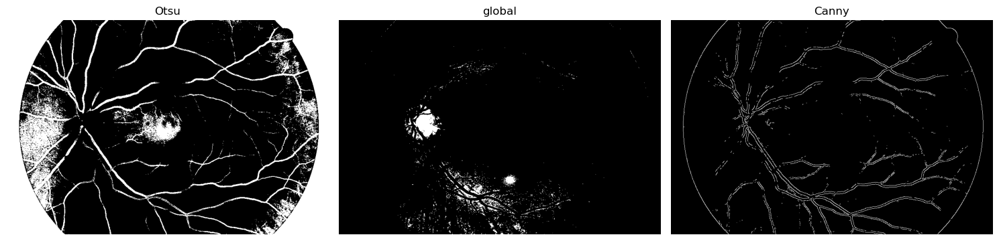

Applying Morphological Operation: open


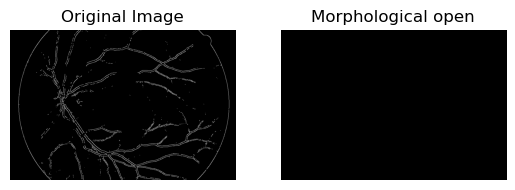

Applying Morphological Operation: close


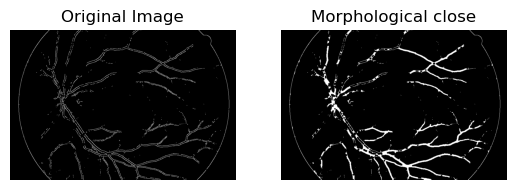

Applying Morphological Operation: gradient


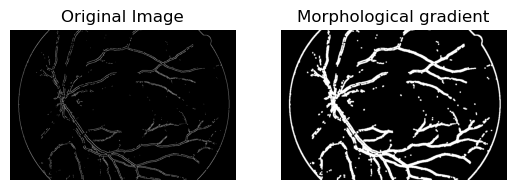

Applying Morphological Operation: tophat


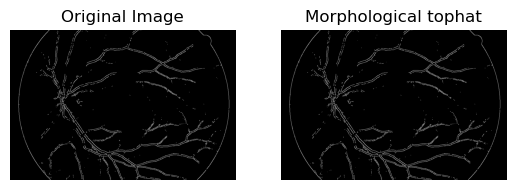

Applying Morphological Operation: blackhat


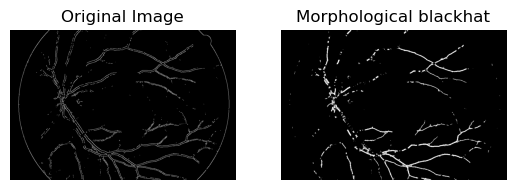

Applying Morphological Operation: dilation


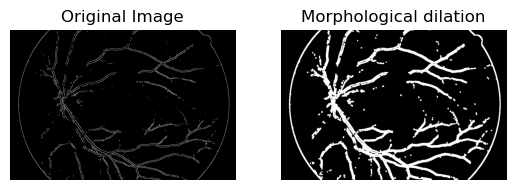

Applying Morphological Operation: erosion


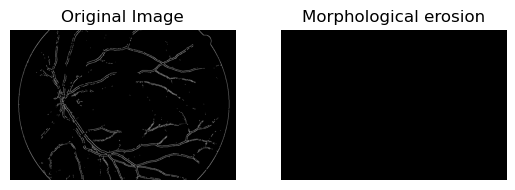

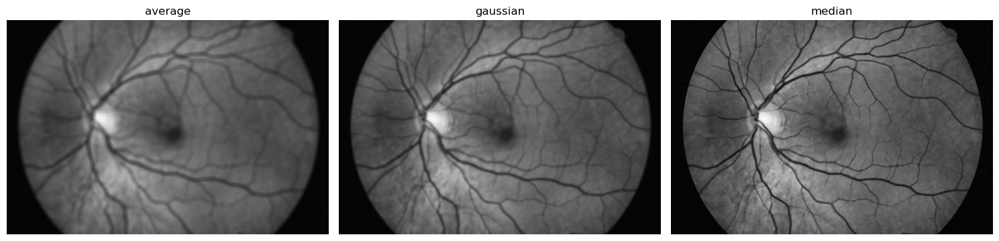

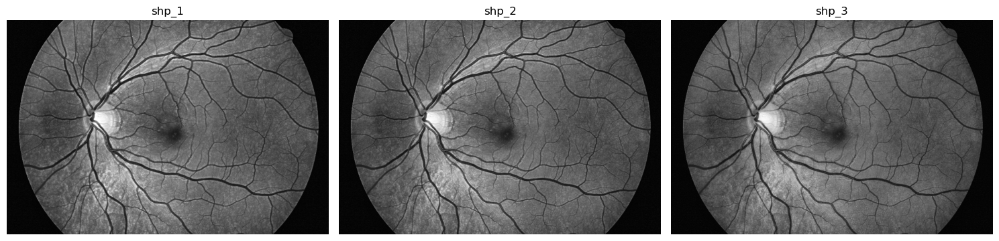

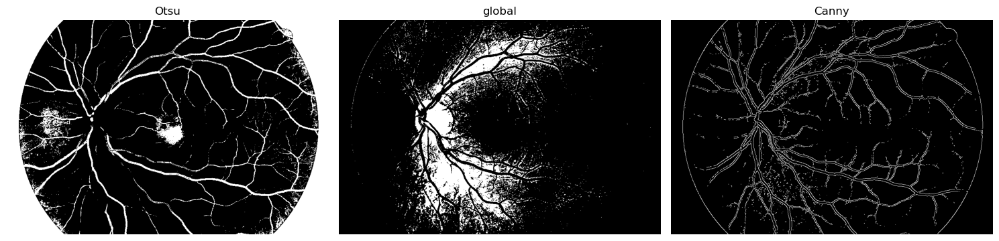

Applying Morphological Operation: open


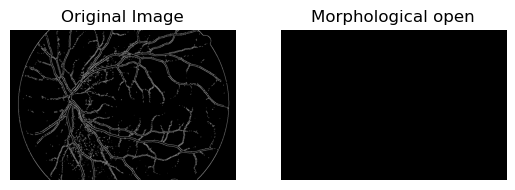

Applying Morphological Operation: close


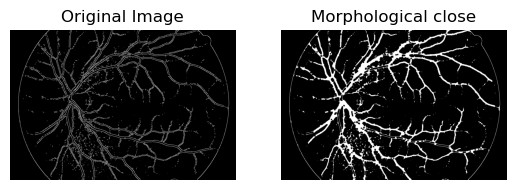

Applying Morphological Operation: gradient


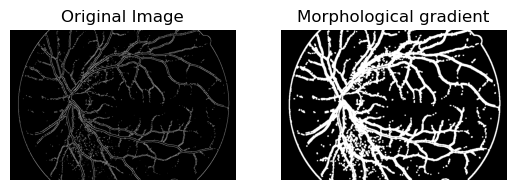

Applying Morphological Operation: tophat


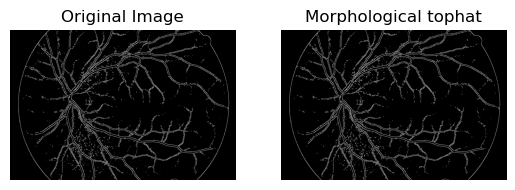

Applying Morphological Operation: blackhat


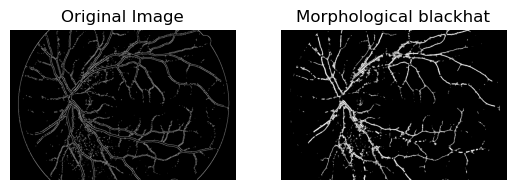

Applying Morphological Operation: dilation


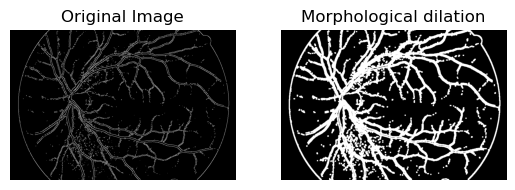

Applying Morphological Operation: erosion


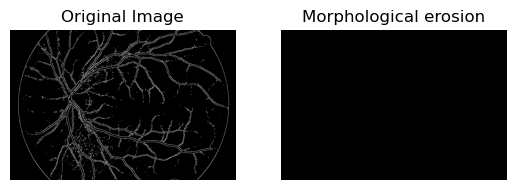

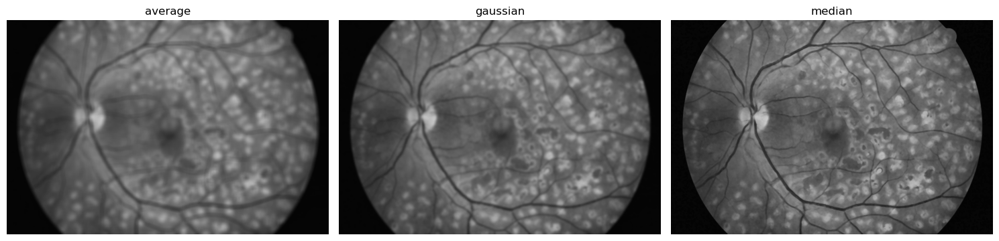

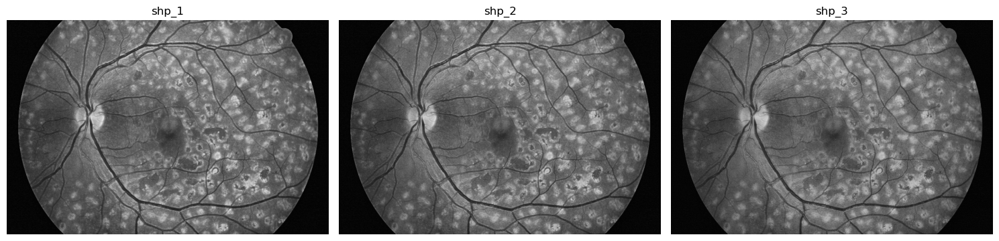

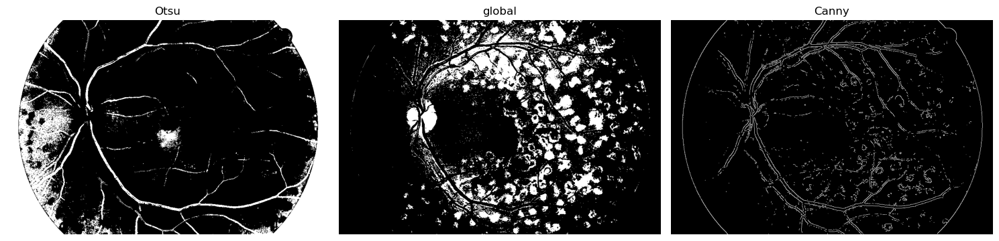

Applying Morphological Operation: open


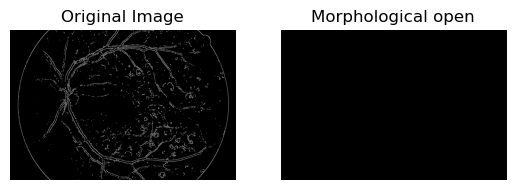

Applying Morphological Operation: close


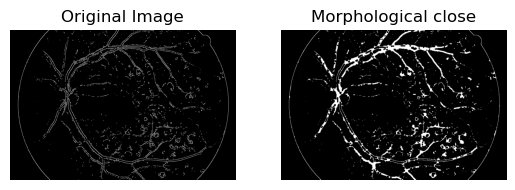

Applying Morphological Operation: gradient


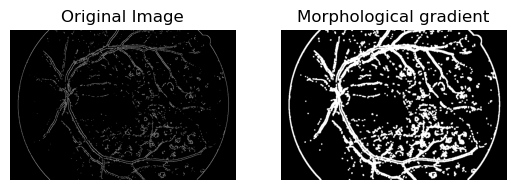

Applying Morphological Operation: tophat


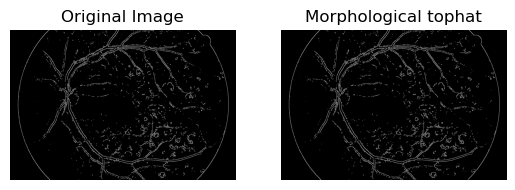

Applying Morphological Operation: blackhat


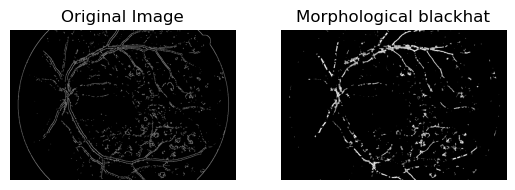

Applying Morphological Operation: dilation


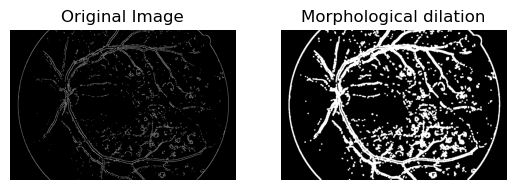

Applying Morphological Operation: erosion


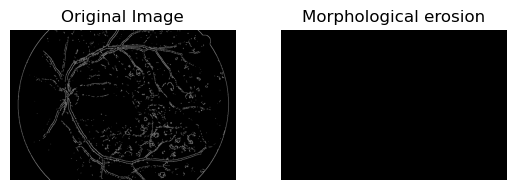

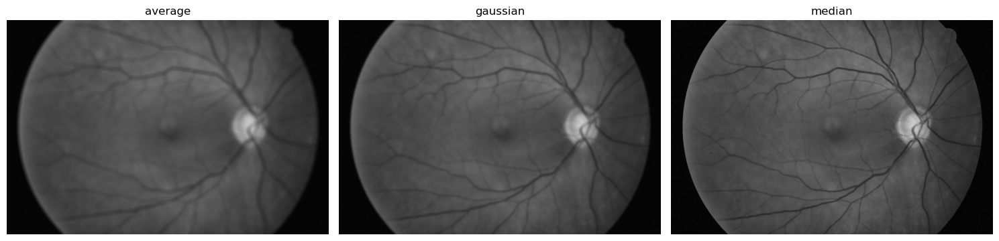

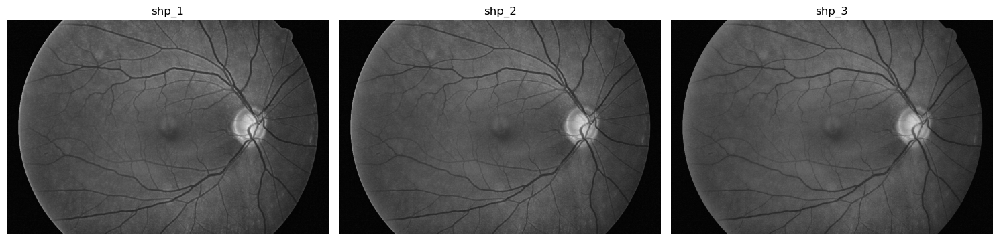

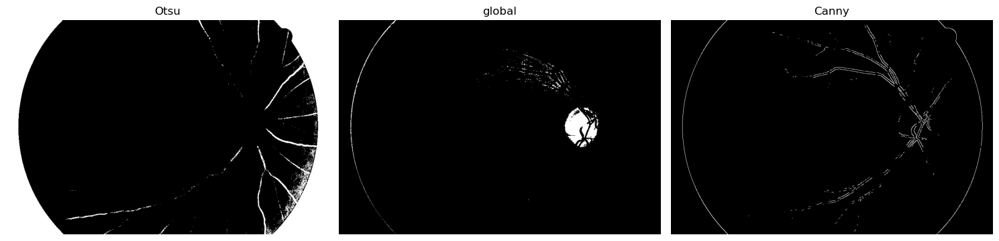

Applying Morphological Operation: open


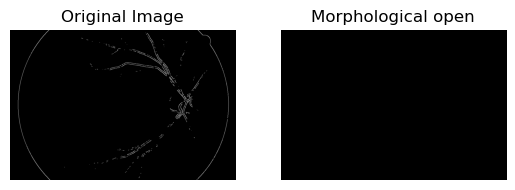

Applying Morphological Operation: close


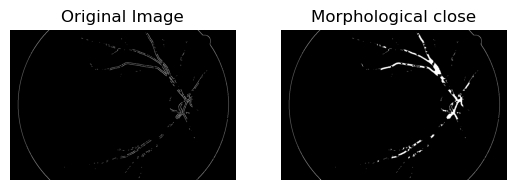

Applying Morphological Operation: gradient


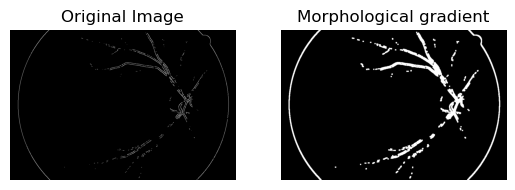

Applying Morphological Operation: tophat


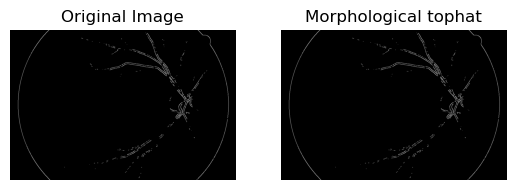

Applying Morphological Operation: blackhat


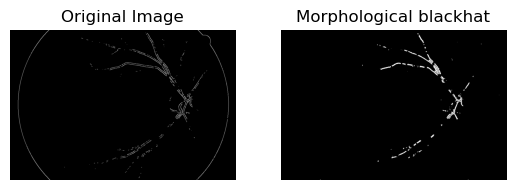

Applying Morphological Operation: dilation


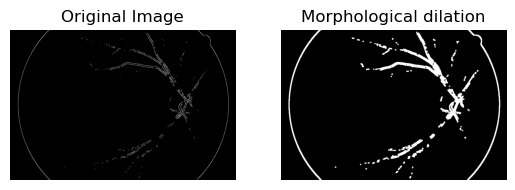

Applying Morphological Operation: erosion


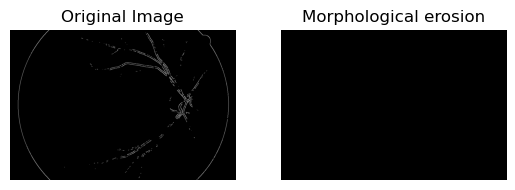

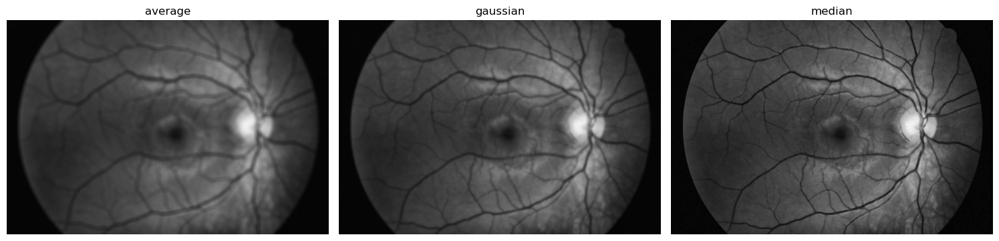

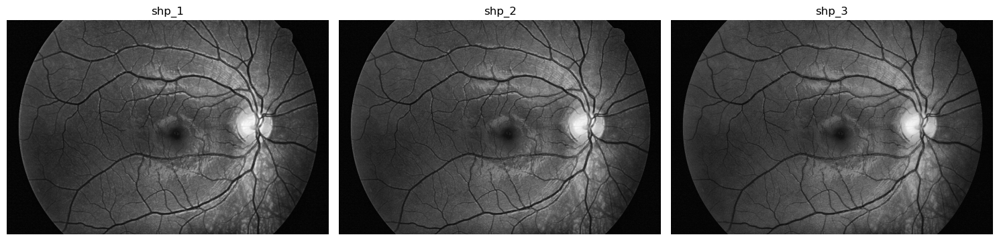

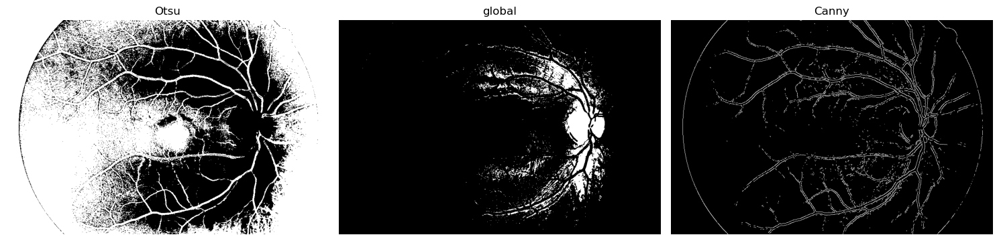

Applying Morphological Operation: open


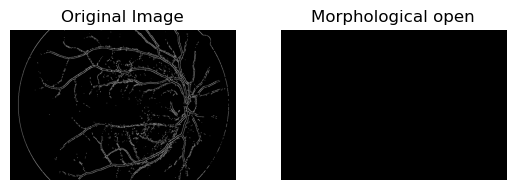

Applying Morphological Operation: close


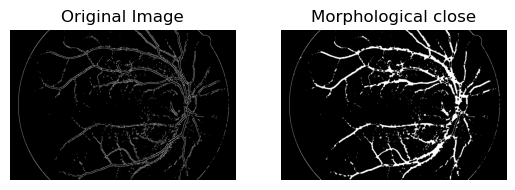

Applying Morphological Operation: gradient


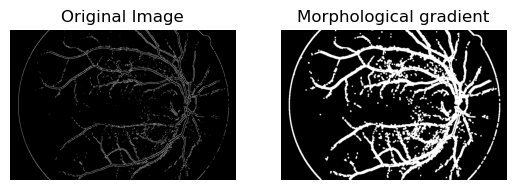

Applying Morphological Operation: tophat


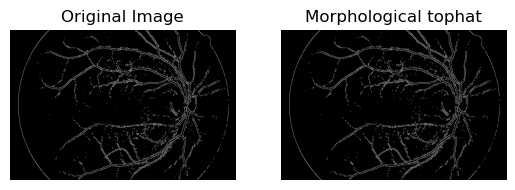

Applying Morphological Operation: blackhat


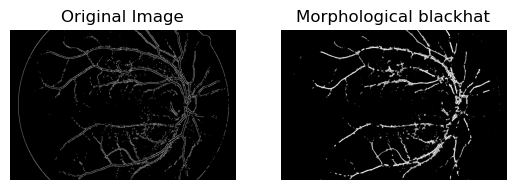

Applying Morphological Operation: dilation


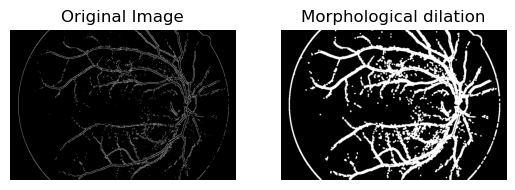

Applying Morphological Operation: erosion


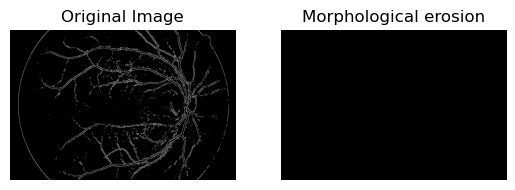

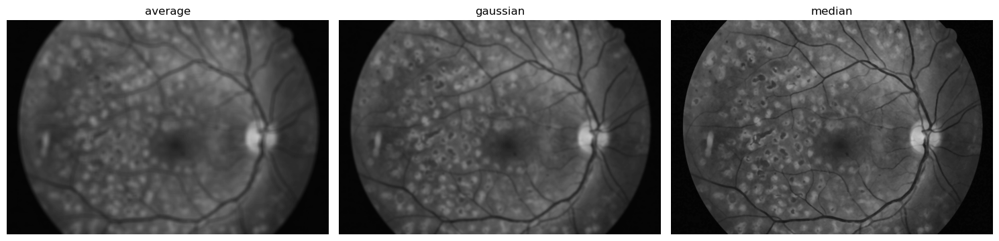

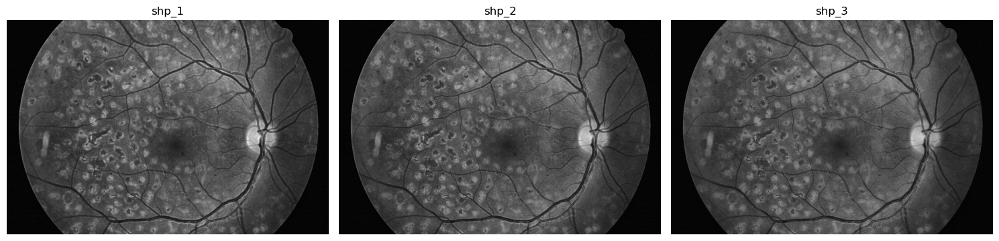

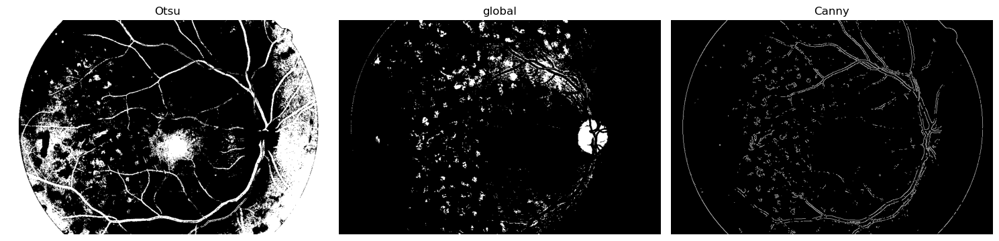

Applying Morphological Operation: open


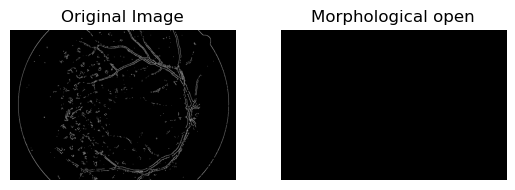

Applying Morphological Operation: close


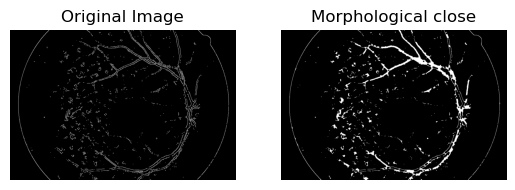

Applying Morphological Operation: gradient


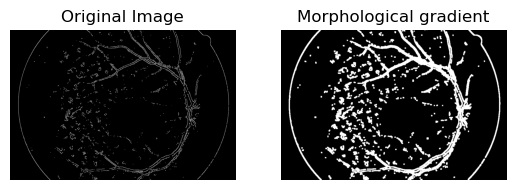

Applying Morphological Operation: tophat


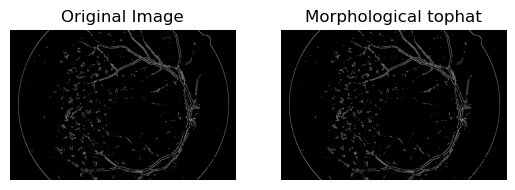

Applying Morphological Operation: blackhat


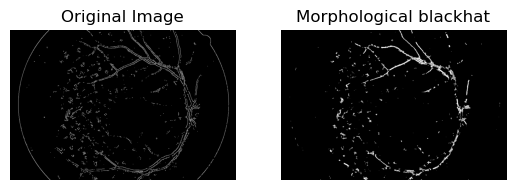

Applying Morphological Operation: dilation


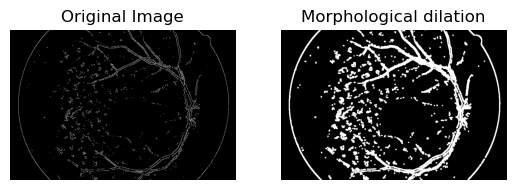

Applying Morphological Operation: erosion


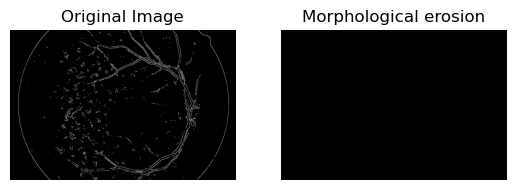

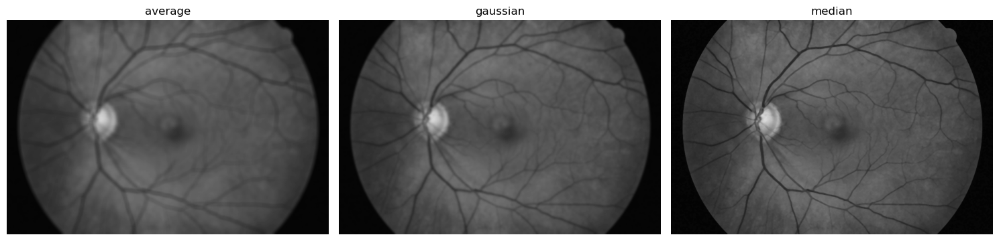

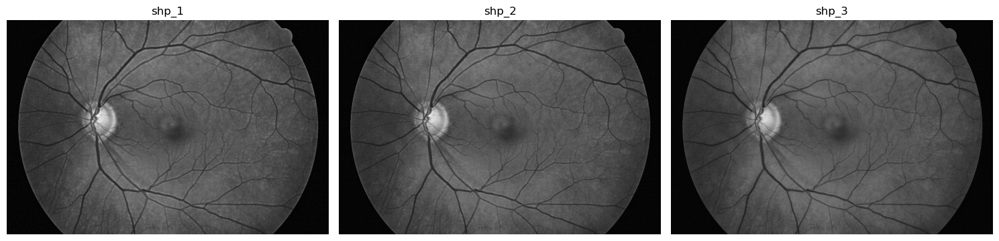

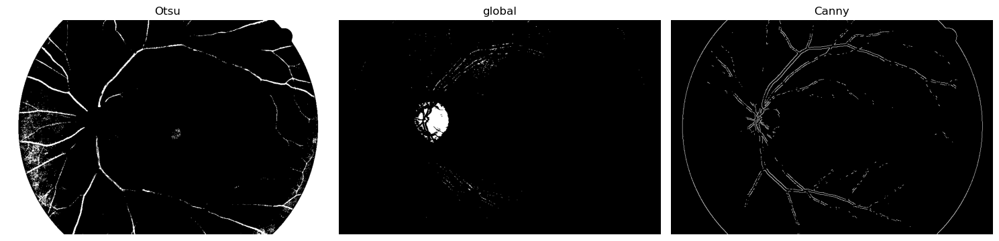

Applying Morphological Operation: open


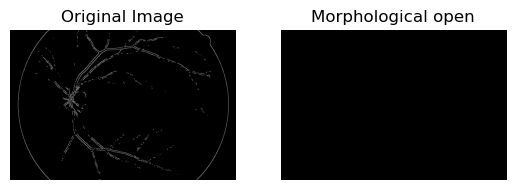

Applying Morphological Operation: close


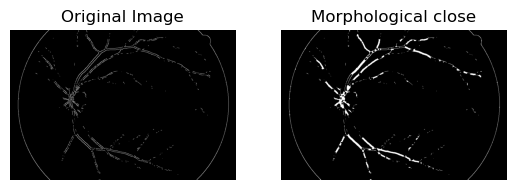

Applying Morphological Operation: gradient


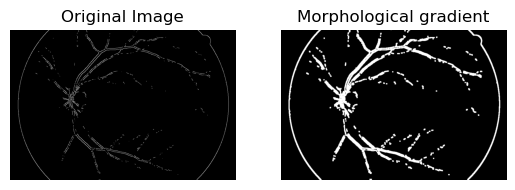

Applying Morphological Operation: tophat


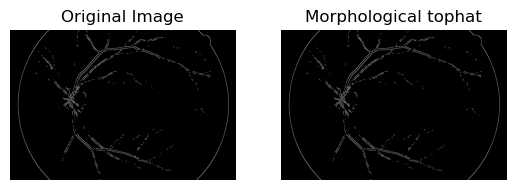

Applying Morphological Operation: blackhat


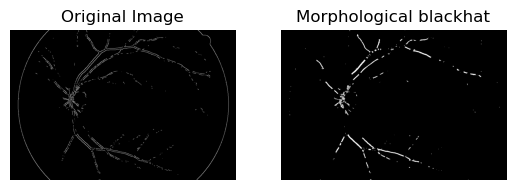

Applying Morphological Operation: dilation


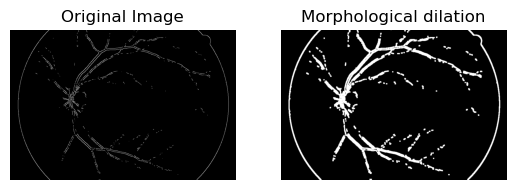

Applying Morphological Operation: erosion


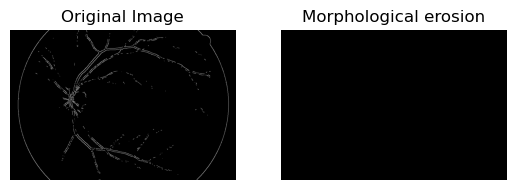

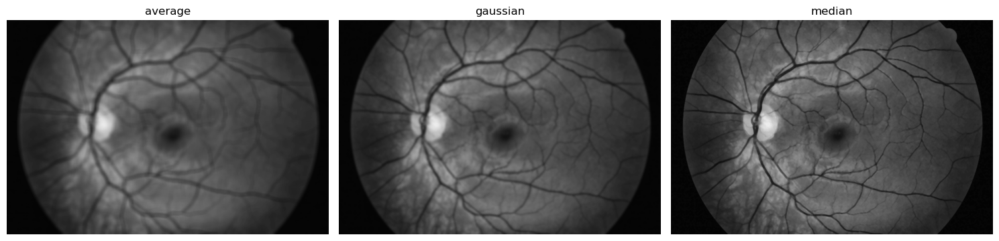

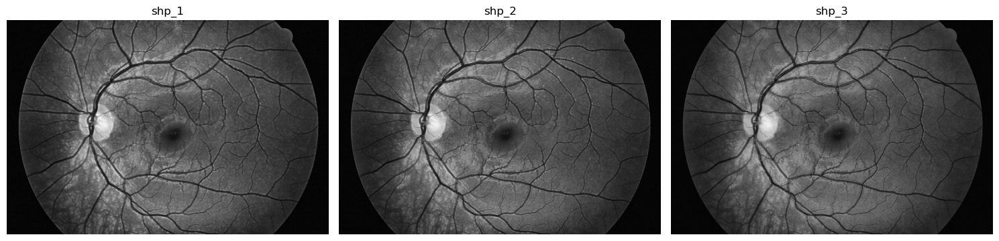

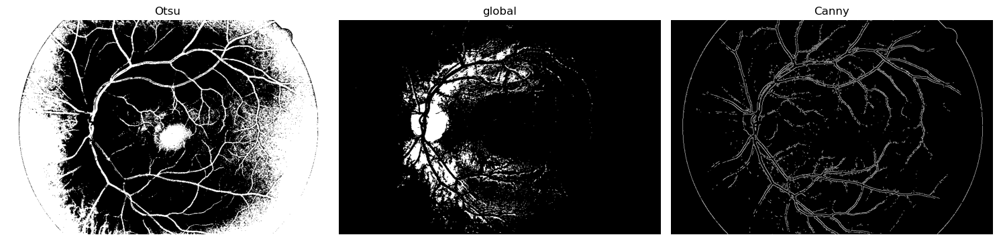

Applying Morphological Operation: open


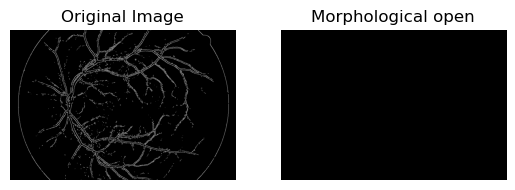

Applying Morphological Operation: close


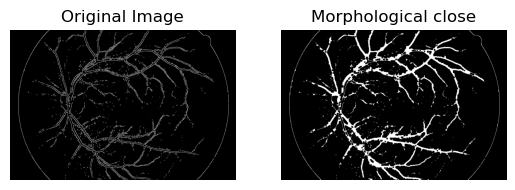

Applying Morphological Operation: gradient


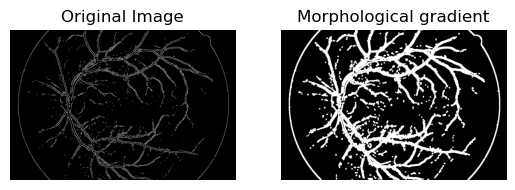

Applying Morphological Operation: tophat


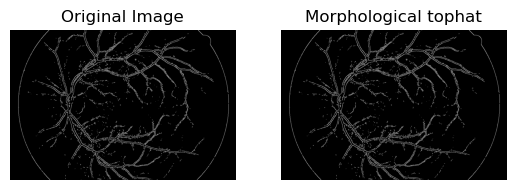

Applying Morphological Operation: blackhat


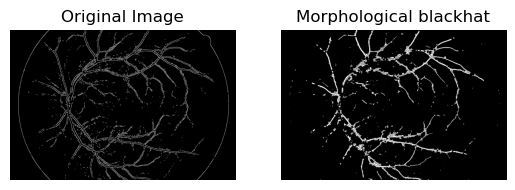

Applying Morphological Operation: dilation


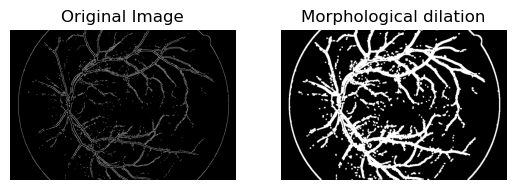

Applying Morphological Operation: erosion


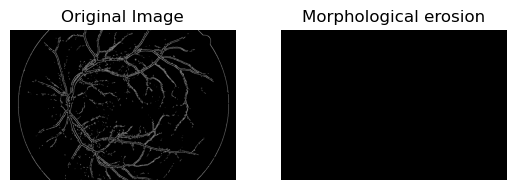

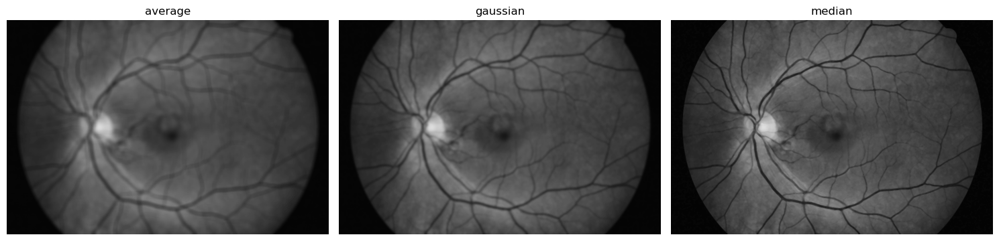

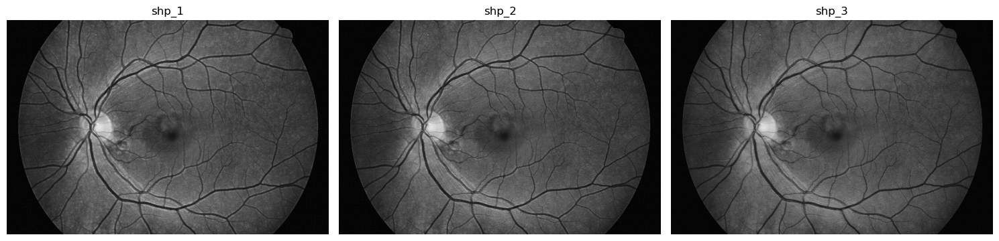

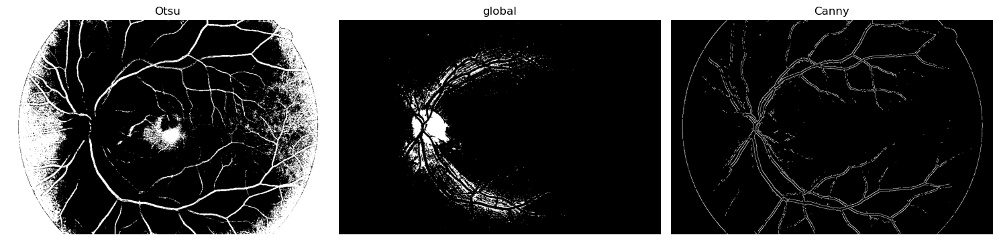

Applying Morphological Operation: open


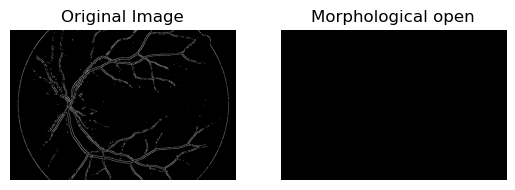

Applying Morphological Operation: close


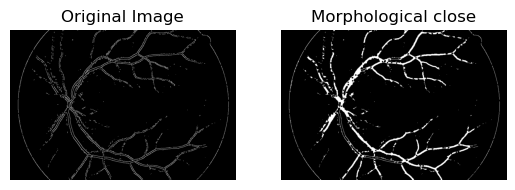

Applying Morphological Operation: gradient


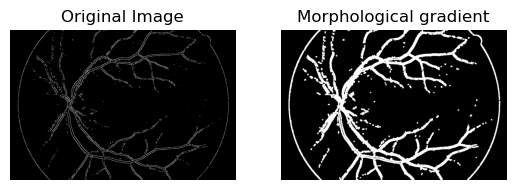

Applying Morphological Operation: tophat


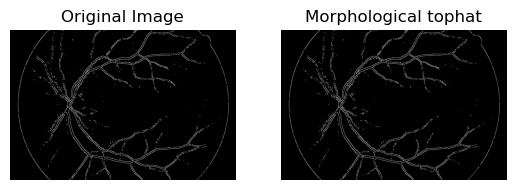

Applying Morphological Operation: blackhat


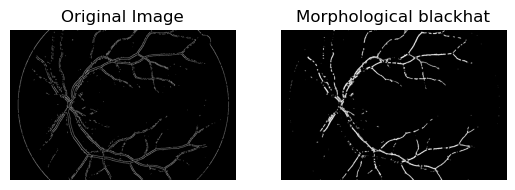

Applying Morphological Operation: dilation


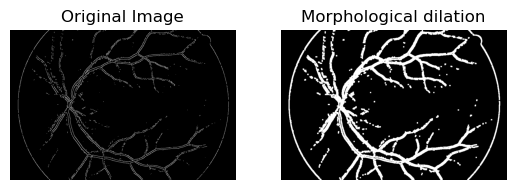

Applying Morphological Operation: erosion


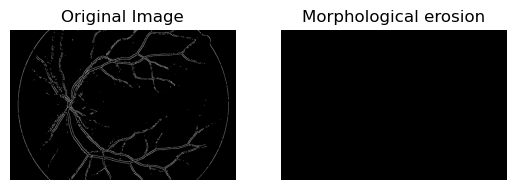

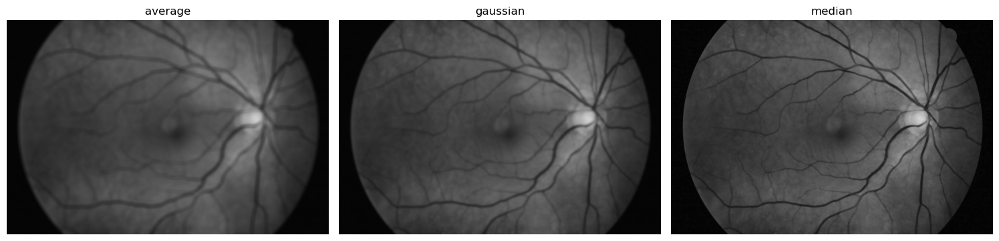

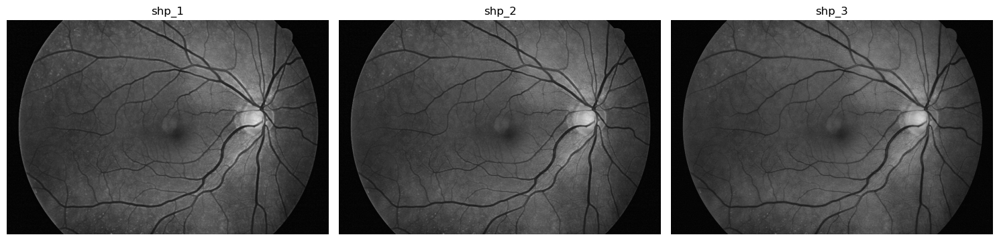

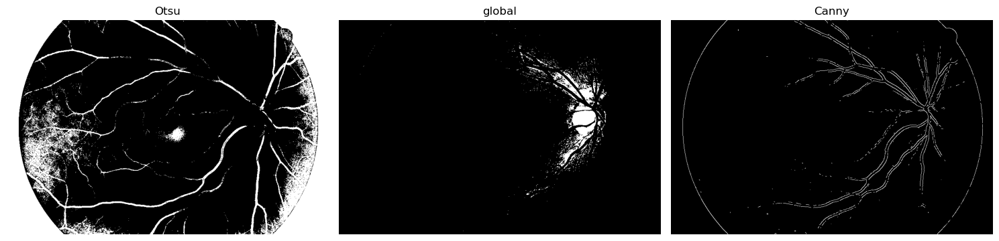

Applying Morphological Operation: open


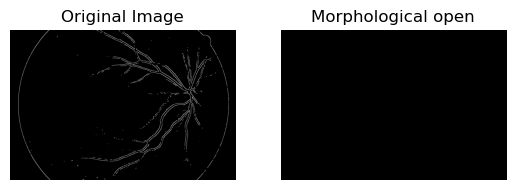

Applying Morphological Operation: close


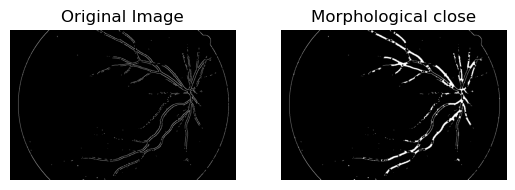

Applying Morphological Operation: gradient


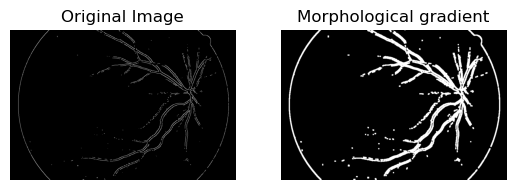

Applying Morphological Operation: tophat


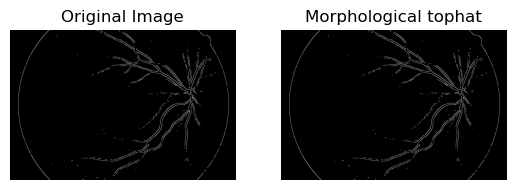

Applying Morphological Operation: blackhat


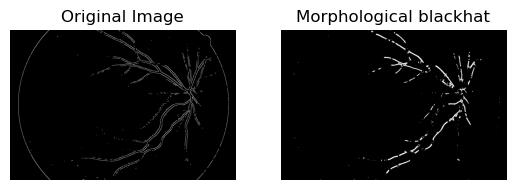

Applying Morphological Operation: dilation


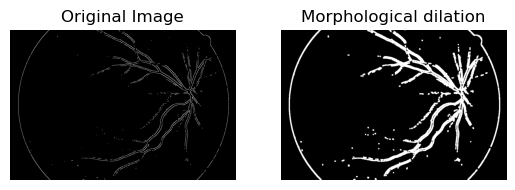

Applying Morphological Operation: erosion


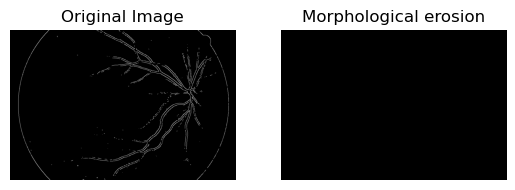

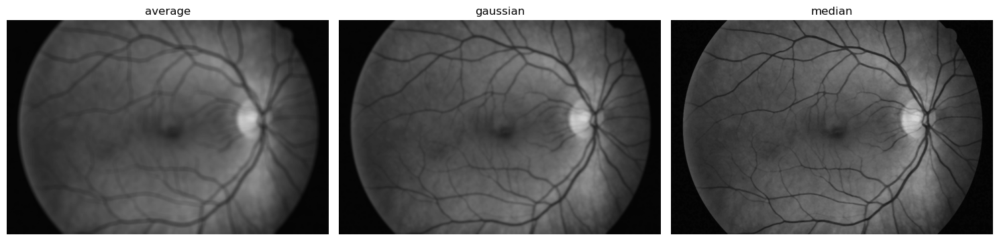

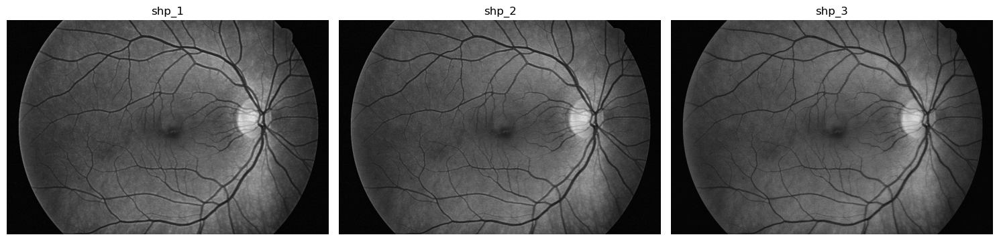

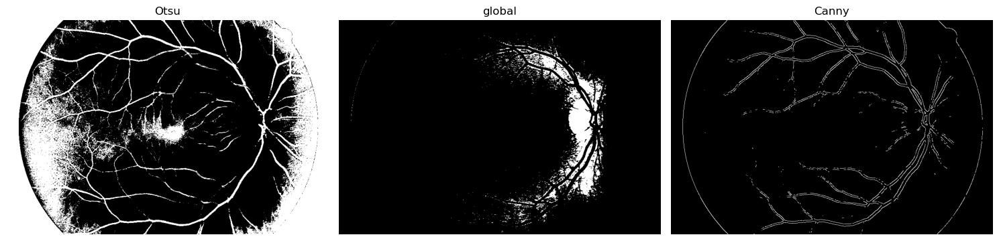

Applying Morphological Operation: open


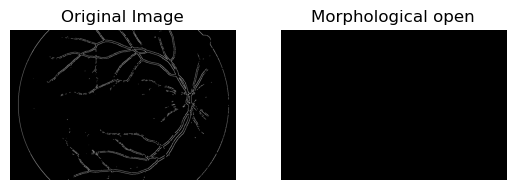

Applying Morphological Operation: close


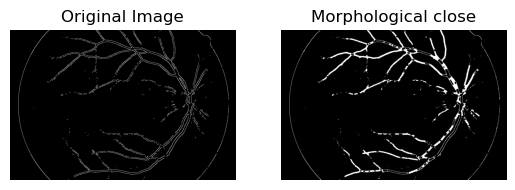

Applying Morphological Operation: gradient


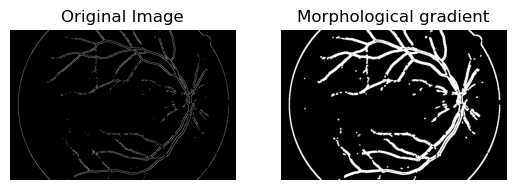

Applying Morphological Operation: tophat


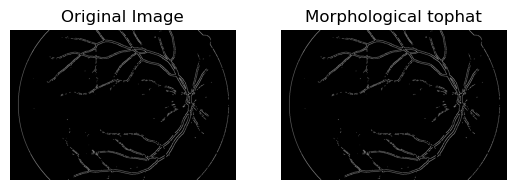

Applying Morphological Operation: blackhat


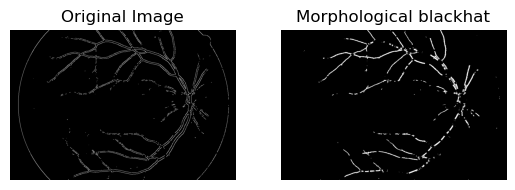

Applying Morphological Operation: dilation


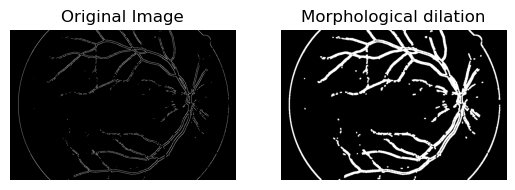

Applying Morphological Operation: erosion


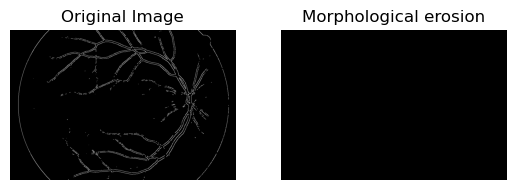

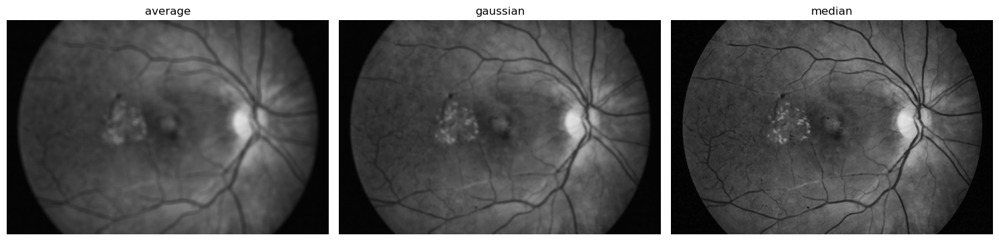

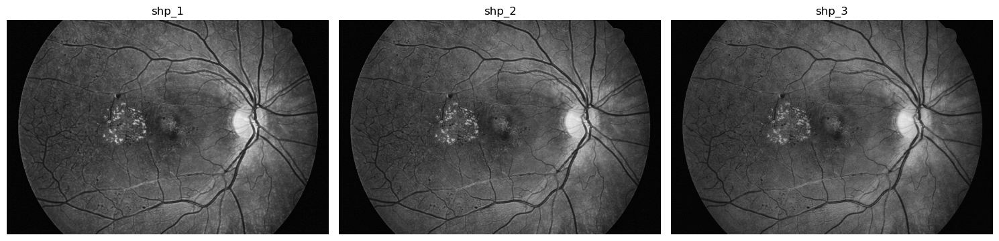

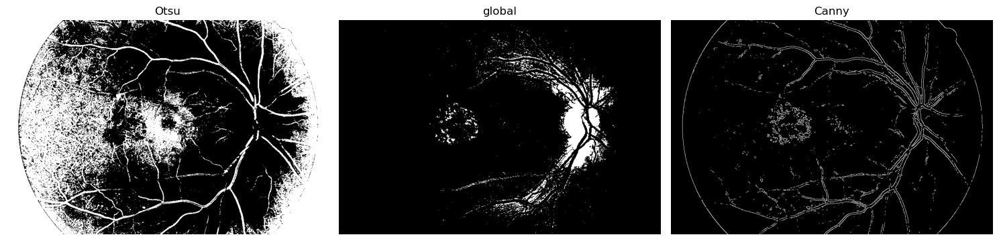

Applying Morphological Operation: open


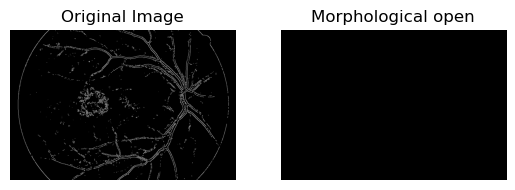

Applying Morphological Operation: close


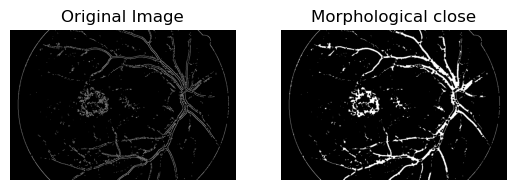

Applying Morphological Operation: gradient


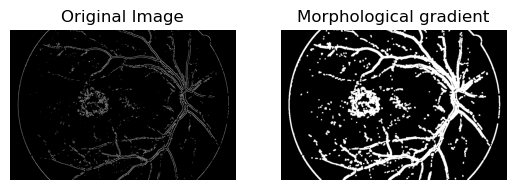

Applying Morphological Operation: tophat


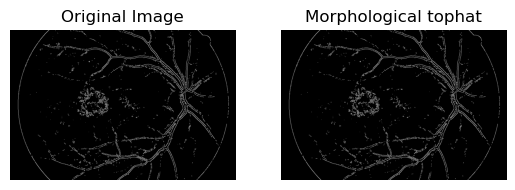

Applying Morphological Operation: blackhat


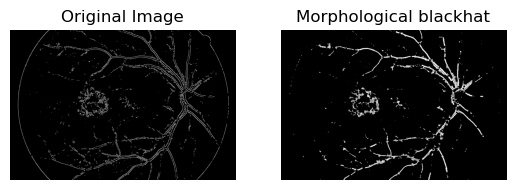

Applying Morphological Operation: dilation


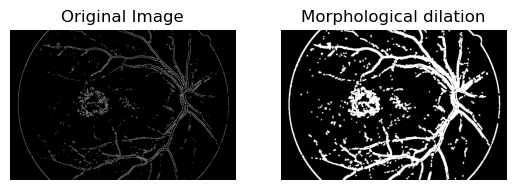

Applying Morphological Operation: erosion


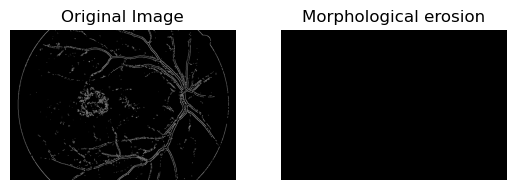

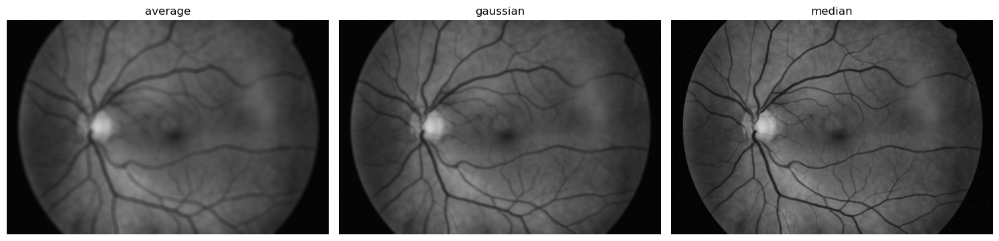

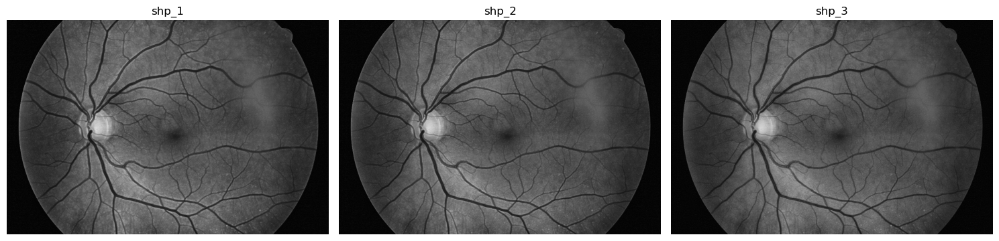

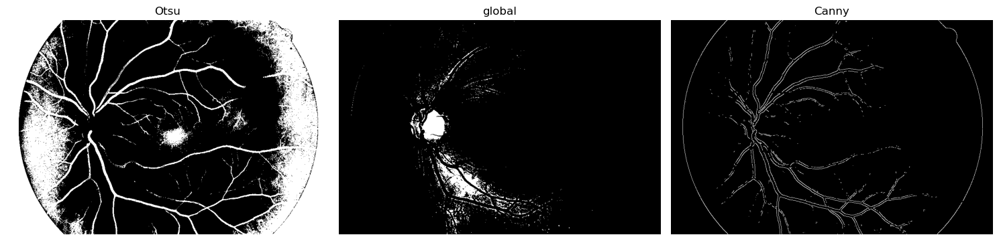

Applying Morphological Operation: open


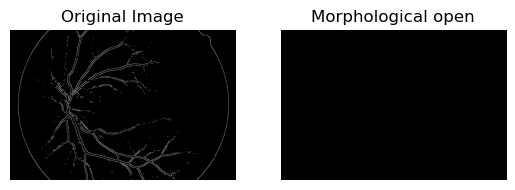

Applying Morphological Operation: close


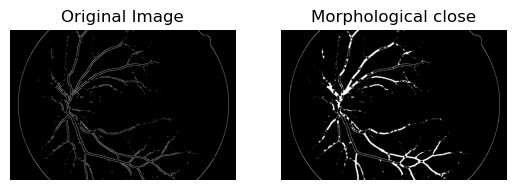

Applying Morphological Operation: gradient


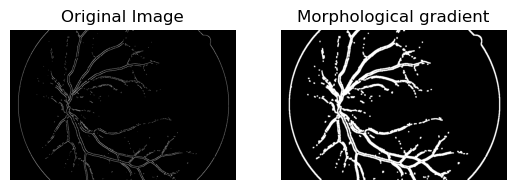

Applying Morphological Operation: tophat


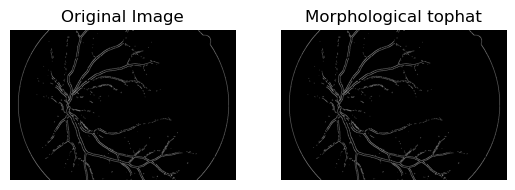

Applying Morphological Operation: blackhat


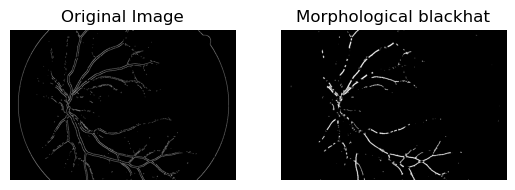

Applying Morphological Operation: dilation


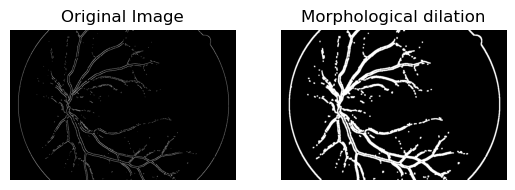

Applying Morphological Operation: erosion


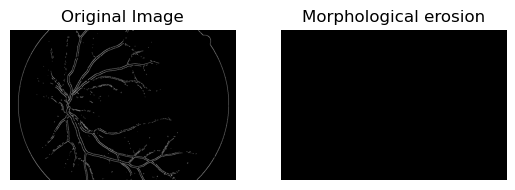

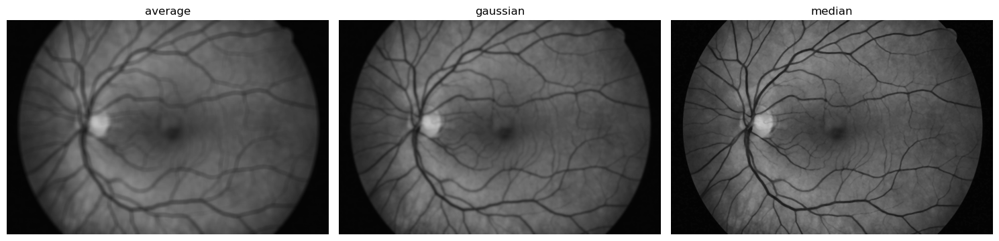

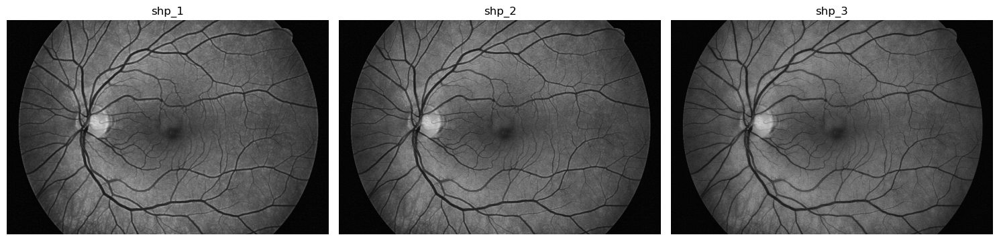

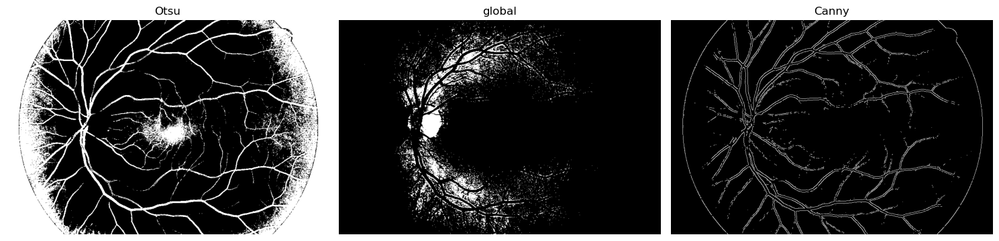

Applying Morphological Operation: open


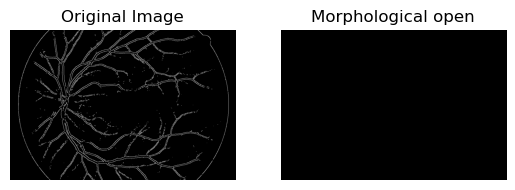

Applying Morphological Operation: close


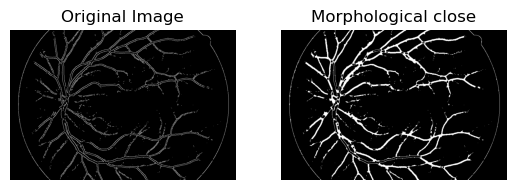

Applying Morphological Operation: gradient


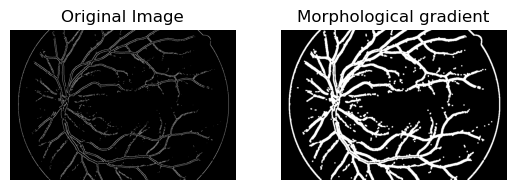

Applying Morphological Operation: tophat


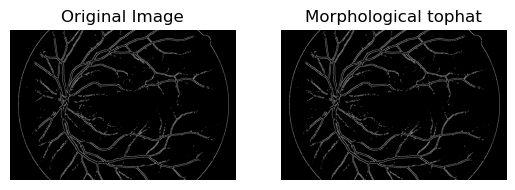

Applying Morphological Operation: blackhat


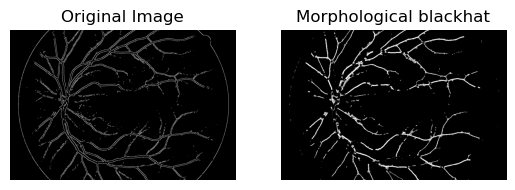

Applying Morphological Operation: dilation


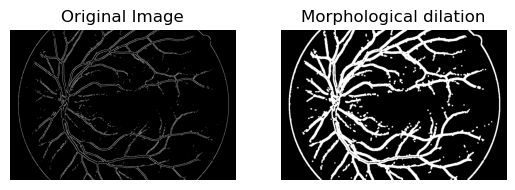

Applying Morphological Operation: erosion


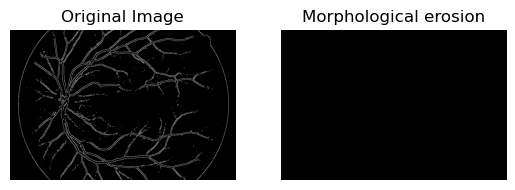

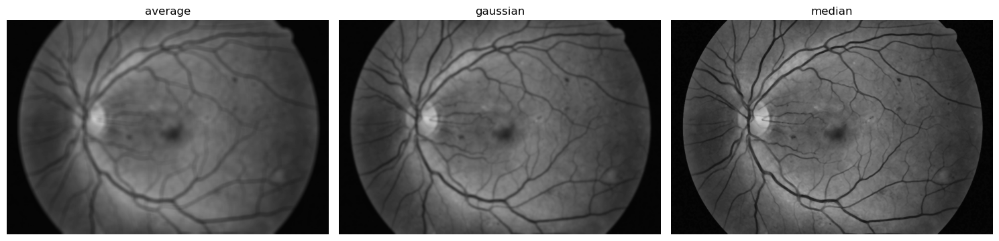

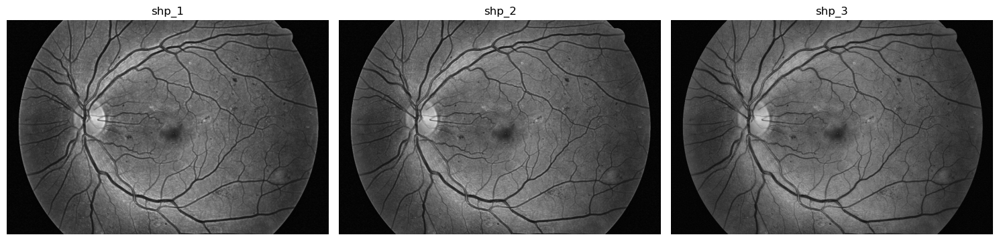

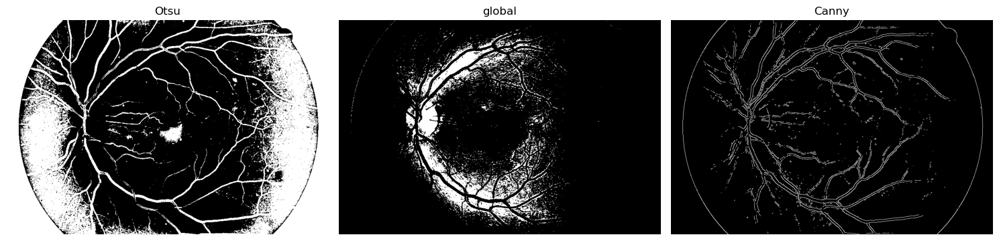

Applying Morphological Operation: open


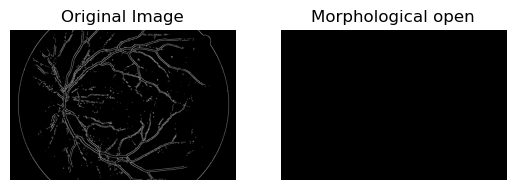

Applying Morphological Operation: close


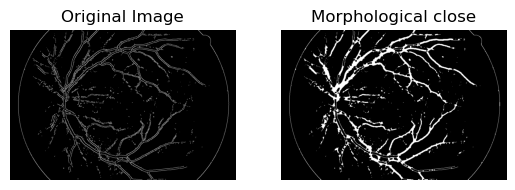

Applying Morphological Operation: gradient


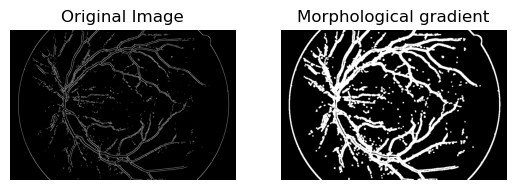

Applying Morphological Operation: tophat


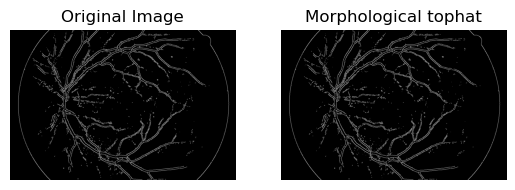

Applying Morphological Operation: blackhat


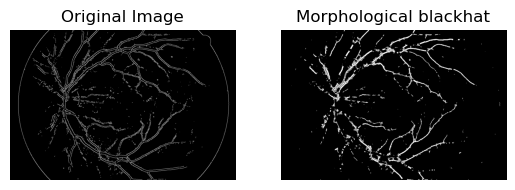

Applying Morphological Operation: dilation


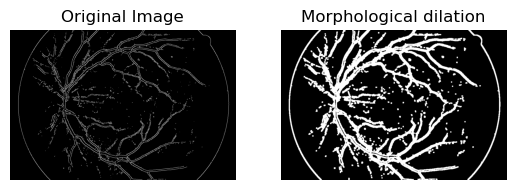

Applying Morphological Operation: erosion


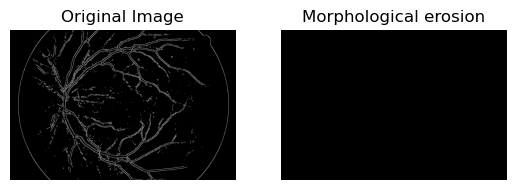

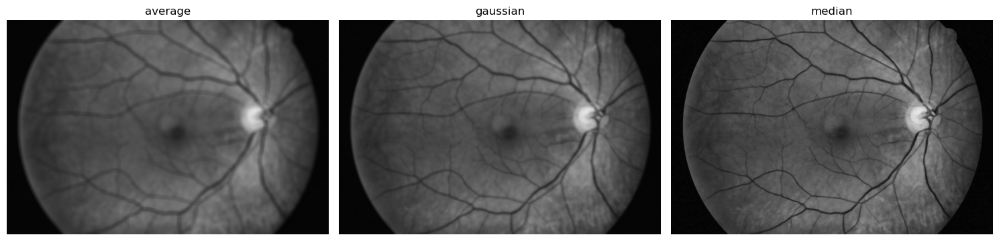

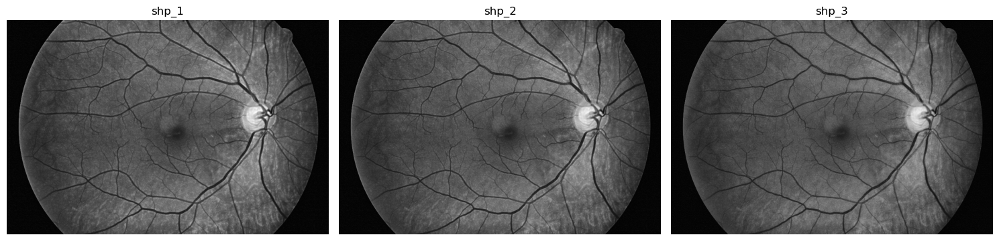

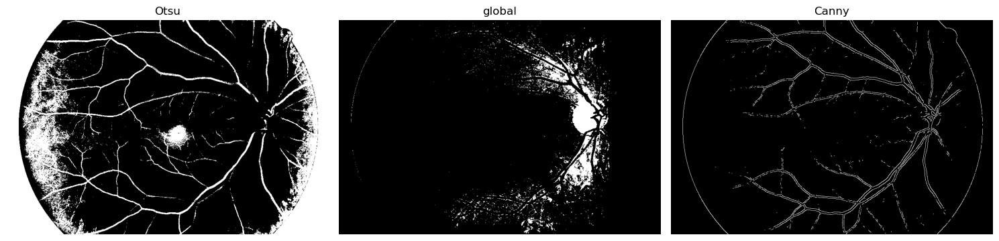

Applying Morphological Operation: open


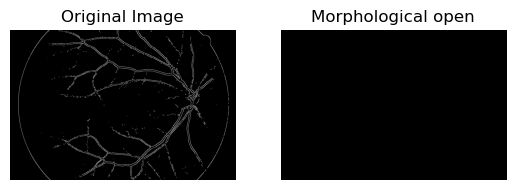

Applying Morphological Operation: close


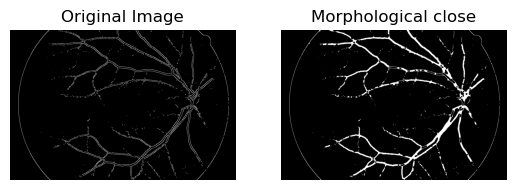

Applying Morphological Operation: gradient


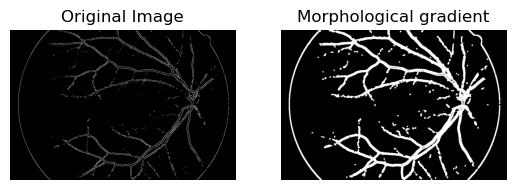

Applying Morphological Operation: tophat


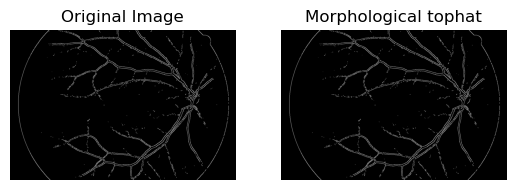

Applying Morphological Operation: blackhat


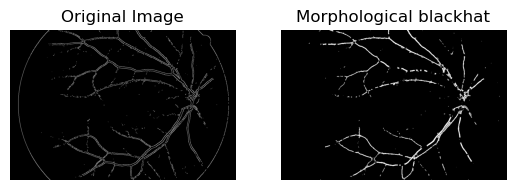

Applying Morphological Operation: dilation


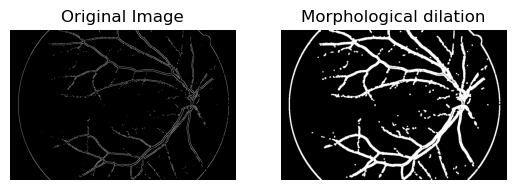

Applying Morphological Operation: erosion


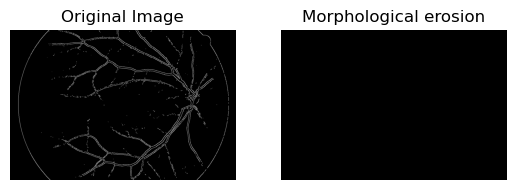

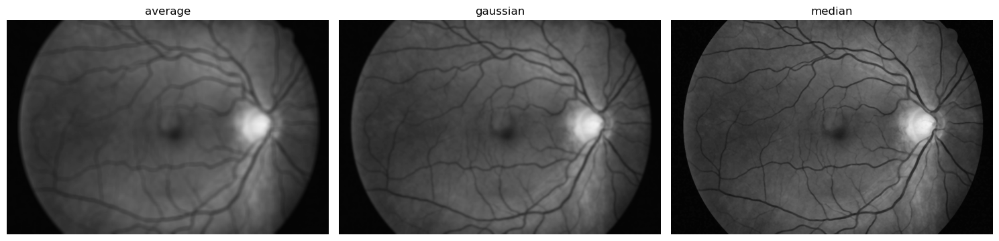

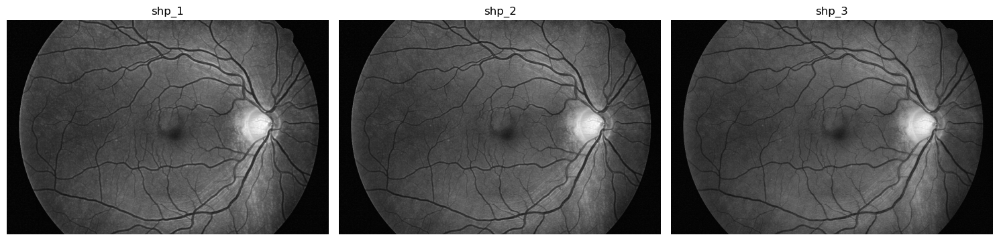

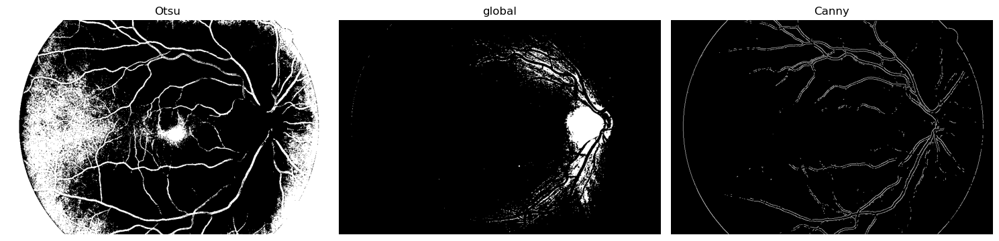

Applying Morphological Operation: open


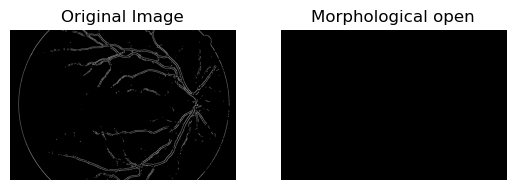

Applying Morphological Operation: close


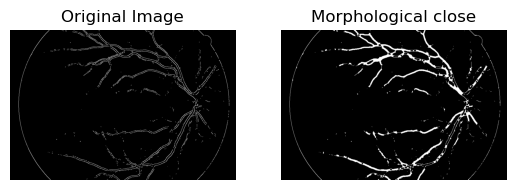

Applying Morphological Operation: gradient


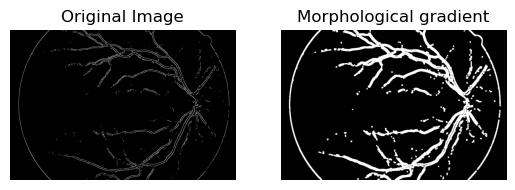

Applying Morphological Operation: tophat


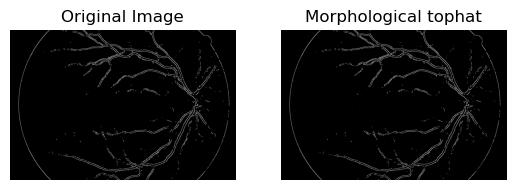

Applying Morphological Operation: blackhat


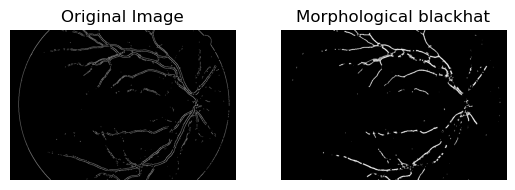

Applying Morphological Operation: dilation


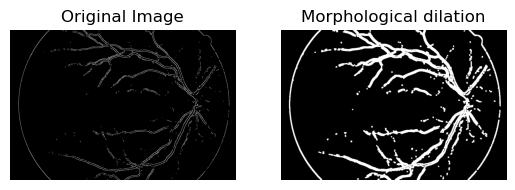

Applying Morphological Operation: erosion


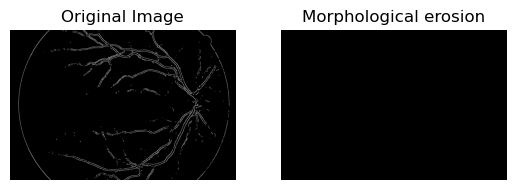

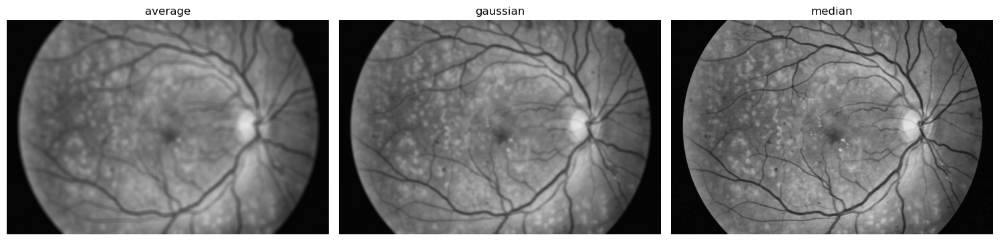

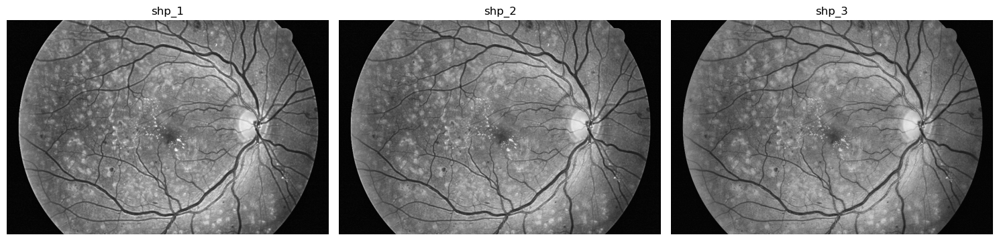

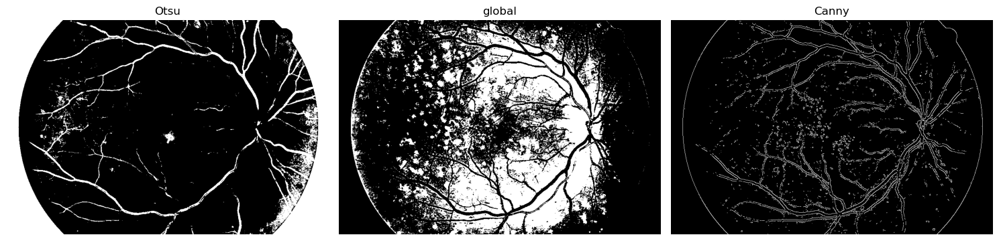

Applying Morphological Operation: open


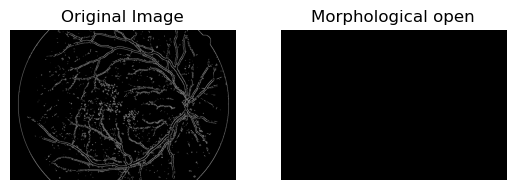

Applying Morphological Operation: close


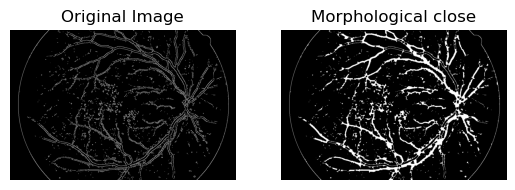

Applying Morphological Operation: gradient


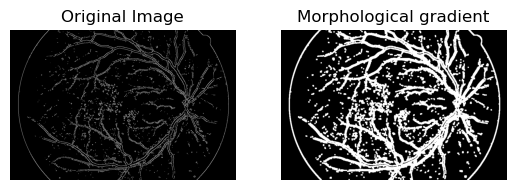

Applying Morphological Operation: tophat


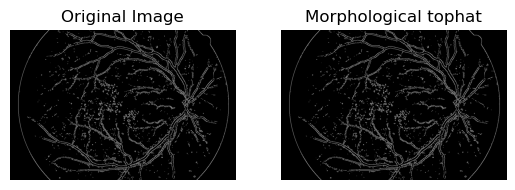

Applying Morphological Operation: blackhat


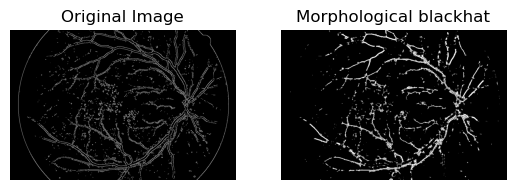

Applying Morphological Operation: dilation


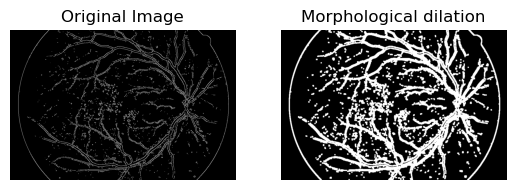

Applying Morphological Operation: erosion


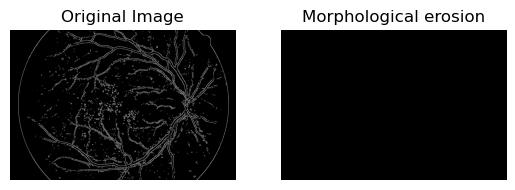

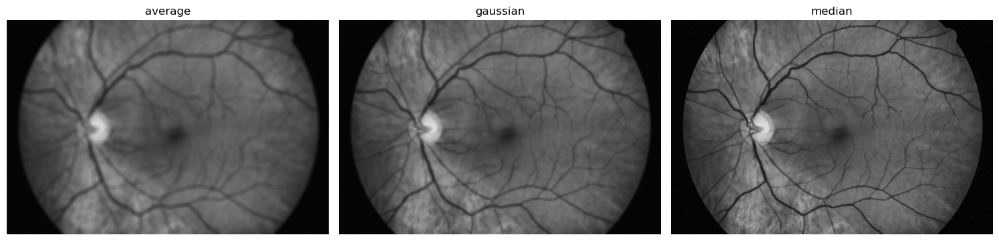

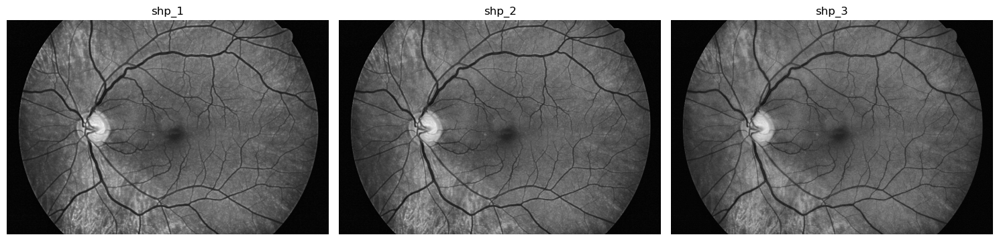

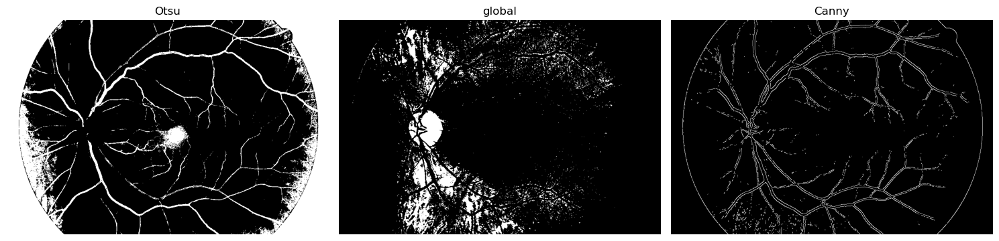

Applying Morphological Operation: open


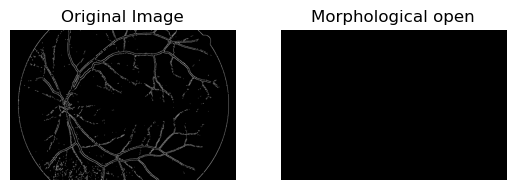

Applying Morphological Operation: close


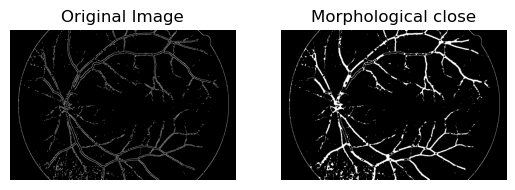

Applying Morphological Operation: gradient


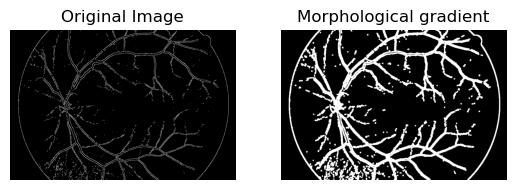

Applying Morphological Operation: tophat


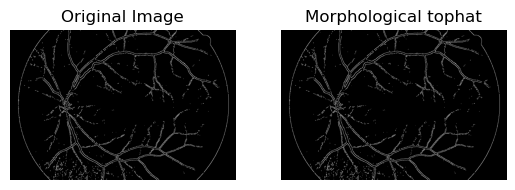

Applying Morphological Operation: blackhat


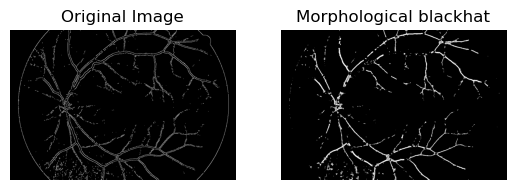

Applying Morphological Operation: dilation


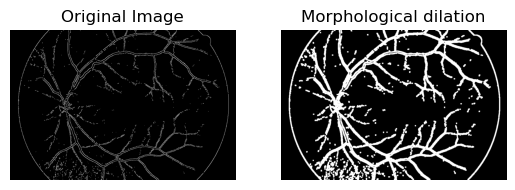

Applying Morphological Operation: erosion


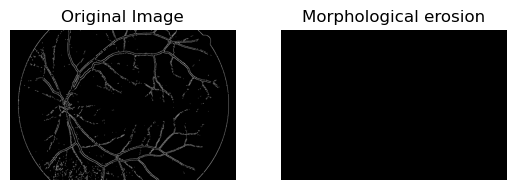

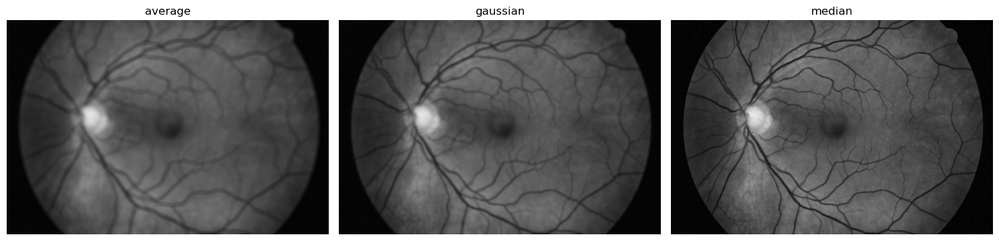

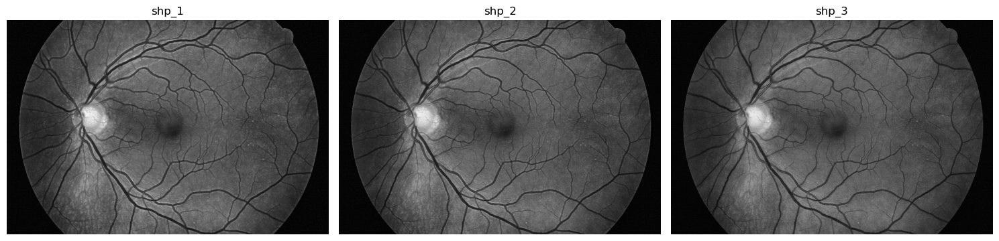

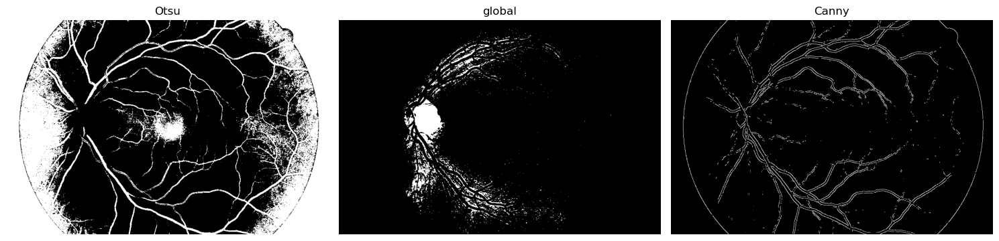

Applying Morphological Operation: open


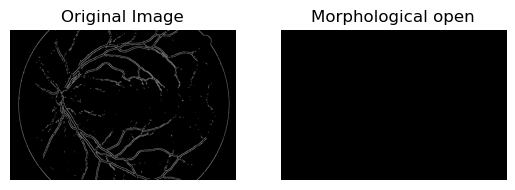

Applying Morphological Operation: close


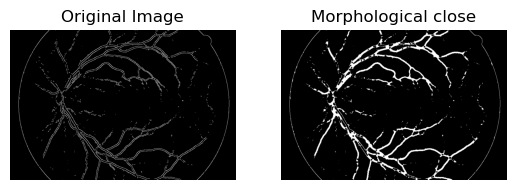

Applying Morphological Operation: gradient


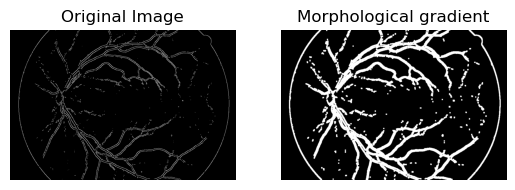

Applying Morphological Operation: tophat


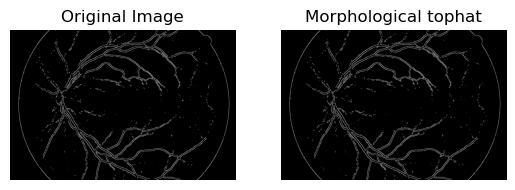

Applying Morphological Operation: blackhat


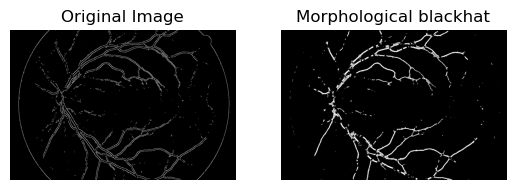

Applying Morphological Operation: dilation


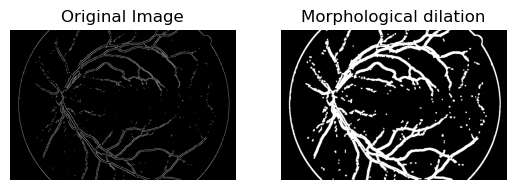

Applying Morphological Operation: erosion


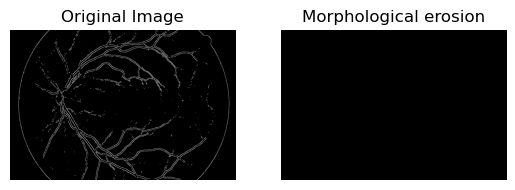

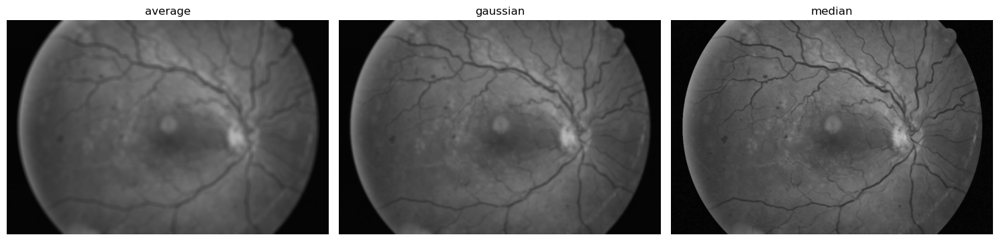

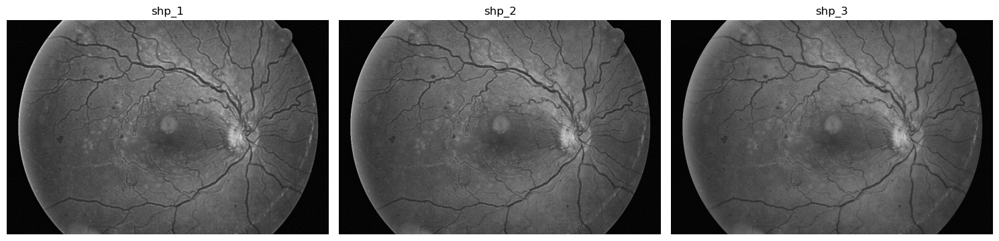

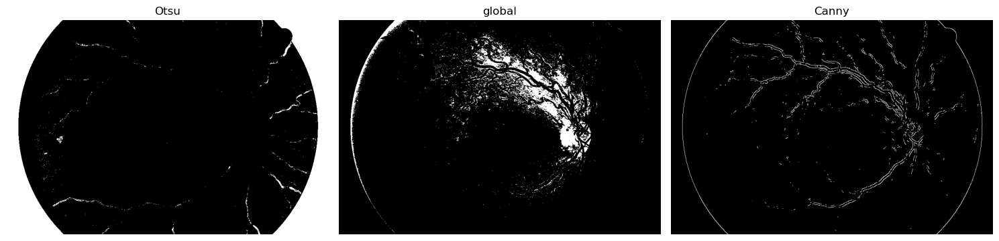

Applying Morphological Operation: open


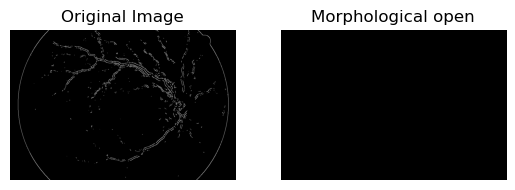

Applying Morphological Operation: close


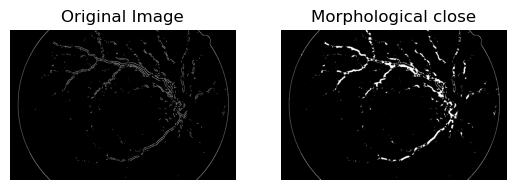

Applying Morphological Operation: gradient


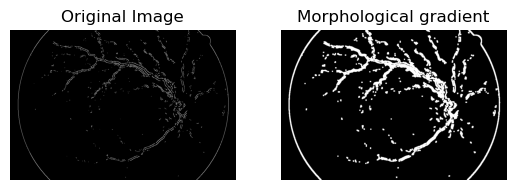

Applying Morphological Operation: tophat


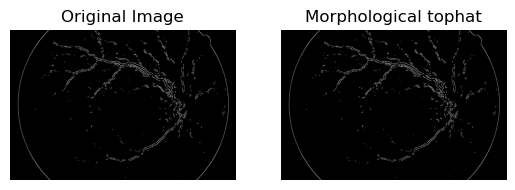

Applying Morphological Operation: blackhat


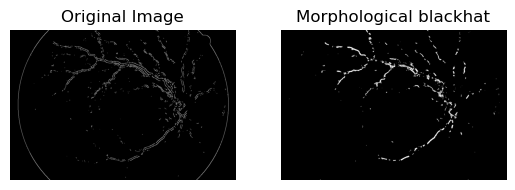

Applying Morphological Operation: dilation


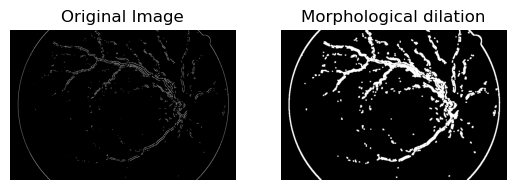

In [ ]:



for i,name in enumerate(files):
    inputImg = cv2.imread(input_dir + '/' + name)
    edge_binary = preProcess(inputImg)

    for option in morph_map.keys():
        print(f"Applying Morphological Operation: {option}")
        multiple_MORPH(edge_binary, kernel, 1, option)